# Visualizations for the ZeoSyn dataset
Paper title: *ZeoSyn: A Comprehensive Zeolite Synthesis Dataset Enabling Machine-learning Rationalization of Hydrothermal Parameters*

In [1]:
# env: zeo_classification
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import math
import pickle
import os
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import AllChem
from rdkit.Chem.Draw import rdMolDraw2D
from PIL import Image
from io import BytesIO
import re
import ast
import tqdm
import copy
from ast import literal_eval

from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OrdinalEncoder, StandardScaler
import umap

from matplotlib.colors import LogNorm

from s4.ml.plotting import periodic_table_heatmap_sbs
from s4.ml.plotting import generate_pt_triangulation
from matplotlib.colors import to_rgb
from matplotlib.colors import ListedColormap

from scipy.spatial import distance
from scipy.cluster import hierarchy
import scipy.stats
from rdkit.Chem import AllChem

In [2]:
# Load synthesis dataset
df      = pd.read_excel('dataset/ZEOSYN.xlsx')

# Load zeolite structural descriptor
df_zeos = pd.read_csv('dataset/zeolite_descriptors.csv').rename(columns = {'Unnamed: 0': 'Code'})

# Load osda descriptors
df_osda = pd.read_csv('dataset/osda_descriptors.csv').drop(columns = {'Unnamed: 0': 'Code'})

In [3]:
df

,Unnamed: 0,Si,Al,P,Na,K,Li,Sr,Rb,Cs,...,osda1 smiles,osda2 smiles,osda3 smiles,osda1 formula,osda2 formula,osda3 formula,Code1,Code2,Code3,year
0,0,0.030769,0.000000,0.0,0.0,0.001538,0.0,0.0,0.0,0.0,...,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCC...,NaN,NaN,C16H29N2,NaN,NaN,AFI,NaN,NaN,2002.0
1,1,0.105263,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCC...,NaN,NaN,C16H29N2,NaN,NaN,AFI,NaN,NaN,2002.0
2,2,0.021959,0.000000,0.0,0.0,0.002635,0.0,0.0,0.0,0.0,...,C[N+](C)(C)C12CC3CC(CC(C3)C1)C2,NaN,NaN,C13H24N,NaN,NaN,AFI,NaN,NaN,2002.0
3,3,0.046512,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,C[N+](C)(C)C12CC3CC(CC(C3)C1)C2,NaN,NaN,C13H24N,NaN,NaN,AFI,NaN,NaN,2002.0
4,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30159,30159,0.967742,0.032258,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,CHA,NaN,NaN,2000.0
30160,30160,0.975610,0.024390,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,CHA,NaN,NaN,2000.0
30161,30161,0.985915,0.014085,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,AFI,NaN,NaN,2000.0
30162,30162,0.990099,0.009901,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,AFI,NaN,NaN,2000.0


In [4]:
# https://programtalk.com/vs4/python/hcji/PyFingerprint/PyFingerprint/heteroencoder.py/
class MorganDictVectorizer(object):
    def __init__(self, radius=2, augment=None):
        self.radius = radius
        self.augment = augment #Not used
        self.dims = None
        
    def fit(self, mols):
        """Analyses the molecules and creates the key index for the creation of the dense array"""
        keys=set()
        for mol in mols:
            fp = AllChem.GetMorganFingerprint(mol,self.radius)
            keys.update(fp.GetNonzeroElements().keys())
        keys = list(keys)
        keys.sort()
        self.keys= np.array(keys)
        self.dims = len(self.keys)
        
    def transform_mol(self, mol, misses=False):
        """ transforms the mol into a dense array using the fitted keys as index
        
            :parameter mol: the RDKit molecule to be transformed
            :parameter misses: wheter to return the number of key misses for the molecule
         """
        assert type(self.keys) is np.ndarray, "keys are not defined or is not an np.array, has the .fit(mols) function been used?"
        #Get fingerprint as a dictionary
        fp = AllChem.GetMorganFingerprint(mol,self.radius)
        fp_d = fp.GetNonzeroElements()
        
        #Prepare the array, and set the values
        #TODO is there a way to vectorize and speed up this?
        arr = np.zeros((self.dims,))
        _misses = 0
        for key, value in fp_d.items():
            if key in self.keys:
                arr[self.keys == key] = value
            else:
                _misses = _misses + 1
        
        if misses:
            return arr, _misses
        else:
            return arr
    
    def transform(self, mols, misses=False):
        """Transforms a list or array of RDKit molecules into a dense array using the key dictionary (see .fit())
        
        :parameter mols: list or array of RDKit molecules
        :parameter misses: Wheter to return the number of key misses for each molecule
        """
        arr = np.zeros((len(mols), self.dims))
        if misses:
            _misses = np.zeros((len(mols),1))
            for i, mol in enumerate(mols):
                arr[i,:], _misses[i] = self.transform_mol(mol, misses=misses)
            return arr, _misses
        else:
            for i, mol in enumerate(mols):
                arr[i,:] = self.transform_mol(mol, misses=False)
            return arr
        
fpgen = MorganDictVectorizer(radius=5)
mols = [Chem.MolFromSmiles(x) for x in df_osda['osda smiles']]
fpgen.fit(mols)
fps = fpgen.transform(mols)
fps = pd.DataFrame(fps, columns = [f'morgan{x}' for x in range(fps.shape[-1])])

df_osda = pd.concat([df_osda, fps], axis = 1)

In [5]:
# Select subset of osda features
osda_cols = [col for col in df_osda.columns if \
                     ('box' not in col) and \
                     ('binding' not in col) and \
                     ('getaway' not in col) and \
                     ('whim' not in col) and \
                     ('std' not in col) \
                    ]
df_osda = df_osda[osda_cols]
df_osda.columns = ['osda_'+col if 'smiles' not in col else col for col in df_osda.columns]
df_osda_all_feats = df_osda

In [6]:
# Merge main dataset with zeolite descriptors, then with osda descriptors
df = df.merge(df_zeos, left_on='Code1', right_on='Code', how = 'left')
df = df.merge(df_osda, left_on='osda1 smiles', right_on='osda smiles', how = 'left')

# Replace NaN in osda featurizations with 0 - physical?
for osda_col in osda_cols:
    df.loc[:, df.columns.str.contains(osda_col)] = df.loc[:, df.columns.str.contains(osda_col)].fillna(0)

In [7]:
# Rename disordered interrupted three-lettered codes to their full names
def rename_disordered_interrupted(truncated_code):
    disordered_interrupted = {
                          'BEA': '*BEA',
                          'MRE': '*MRE',
                          'STO': '*STO',
                          'SVY': '*-SVY',
                          'CTH': '*CTH',
                          'ITV': '-ITV',
                          'CLO': '-CLO',
                          'ITN': '*-ITN',
                          'UOE': '*UOE',
                          'IRY': '-IRY',
                          'SVR': '-SVR',
                          'LIT': '-LIT',
                          'IFT': '-IFT',
                          'SFV': '*SFV',
                          'IFU': '-IFU',
                         }
    if truncated_code in disordered_interrupted.keys():
        return disordered_interrupted[truncated_code]
    else:
        return truncated_code

df_zeos['Code'] = df_zeos['Code'].apply(rename_disordered_interrupted)

In [8]:
# Small pore zeolites (8MR), Medium pore zeolites (10MR), Large pore zeolites (12MR), Extra large pore zeolites (>12MR)
s_pore = list(df_zeos[(df_zeos['ring_size_0'] >  0.) \
                    & (df_zeos['ring_size_0'] <= 8.) \
                    & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

m_pore = list(df_zeos[(df_zeos['ring_size_0'] > 8.) \
           & (df_zeos['ring_size_0'] <= 10.) \
           & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

l_pore = list(df_zeos[(df_zeos['ring_size_0'] > 10.) \
                    & (df_zeos['ring_size_0'] <= 12.) \
                    & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

xl_pore = list(df_zeos[(df_zeos['ring_size_0'] > 12.) \
                     & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

In [9]:
# look at pore distribution
df_s_pore = df[df['Code1'].isin(s_pore)]
df_m_pore = df[df['Code1'].isin(m_pore)]
df_l_pore = df[df['Code1'].isin(l_pore)]
df_xl_pore = df[df['Code1'].isin(xl_pore)]

print('Number of synthesis routes resulting in small, medium, large, x-large pore zeolite:')
len(df_s_pore), \
len(df_m_pore), \
len(df_l_pore), \
len(df_xl_pore) 

Number of synthesis routes resulting in small, medium, large, x-large pore zeolite:


(5250, 5494, 5769, 716)

In [10]:
df_s_pore['Code1'].value_counts().index

Index(['CHA', 'LTA', 'AEI', 'LEV', 'ANA', 'SOD', 'AEN', 'GIS', 'NON', 'AST',
       'ERI', 'DDR', 'RTH', 'MTN', 'MRT', 'RHO', 'ITE', 'AFX', 'ITW', 'DOH',
       'AWO', 'RUT', 'MER', 'ABW', 'PHI', 'LOS', 'EDI', 'SAV', 'SAS', 'MTF',
       'KFI', 'ZON', 'ATN', 'AFN', 'PAU', 'NSI', 'SGT', 'JSW', 'AFV', 'AVL',
       'SWY', 'UFI', 'ETL', 'APC', 'RTE', 'JBW', 'APD', 'CDO', 'MWF', 'MSO',
       'SVV', 'AVE', 'IHW', 'UOZ', 'OWE', 'DFT', 'PWN', 'AWW', 'SFW', 'ATT',
       'LTJ', 'ESV', 'THO', 'LTN', 'EEI', 'POR', 'ACO', 'IRN', 'CAS', 'EAB',
       'BCT', 'ATV', 'SAT'],
      dtype='object')

In [11]:
df_m_pore['Code1'].value_counts().index

Index(['MFI', 'MWW', 'TON', 'AEL', 'FER', 'MTT', 'MEL', 'STF', '*MRE', 'ITH',
       'EUO', 'STW', 'SZR', 'AFO', 'STT', 'IMF', 'CSV', 'TUN', 'CGS', 'MFS',
       'NES', 'STI', 'NAT', 'PON', 'LAU', 'HEU', '*UOE', 'UOS', 'PWW', 'ITR',
       '-SVR', '-LIT', 'SFF', 'IFW', 'JST', 'PTY', 'SBN', 'SFG', 'RSN', 'VSV',
       'PWO', 'EWS', 'RRO', 'JRY', 'MVY', 'CGF', 'ETV', 'AHT'],
      dtype='object')

In [12]:
df_l_pore['Code1'].value_counts().index

Index(['*BEA', 'AFI', 'MTW', 'FAU', 'MOR', 'BEC', 'EMT', 'IWR', 'ATO', 'MAZ',
       '*STO', 'LTL', 'ISV', 'IFR', 'IWW', 'VET', 'ATS', 'OFF', 'MEI', 'GME',
       'CON', 'BPH', 'SFO', 'MSE', 'CAN', 'UOV', 'IWV', 'SFE', 'ITG', '*-ITN',
       'EZT', 'AFY', 'AFS', 'AFR', 'ASV', 'SFS', 'SAF', 'SSY', 'SBE', 'EON',
       'IWS', 'YFI', 'SAO', 'BOG', 'USI', 'DFO', '*SFV', 'BSV', 'CZP', 'RWY',
       'UWY', 'MOZ', 'GON', 'SOS', 'SSF', 'PUN', 'SOV', 'SOR', 'POS', 'LTF',
       'SOF', 'JSR'],
      dtype='object')

In [13]:
df_xl_pore['Code1'].value_counts().index

Index(['UTL', 'IRR', '*-SVY', '*CTH', 'ITT', '-ITV', 'CFI', '-CLO', 'VFI',
       '-IRY', 'IFO', '-IFT', 'SFH', 'SFN', '-IFU', 'ETR', 'DON'],
      dtype='object')

# Zeolite framework distribution

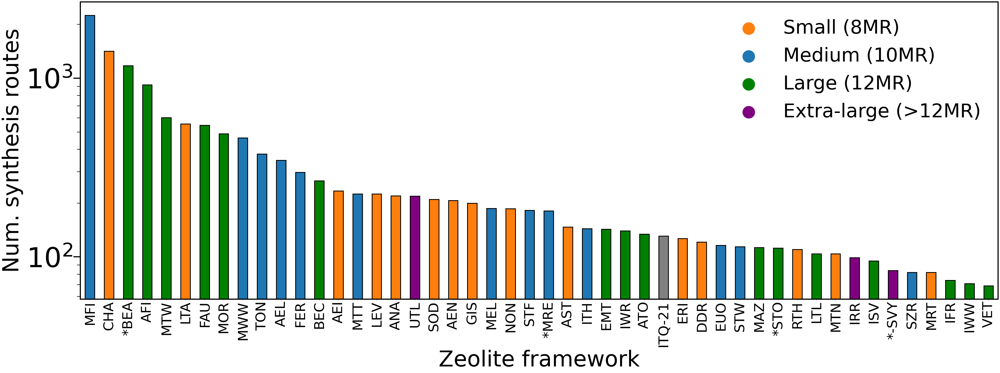

In [14]:
n_frameworks = 50
zeos_value_counts = df['Code1'].value_counts()[:n_frameworks]
zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]

fig, ax = plt.subplots(figsize=(60,20))

# Create colors, orange for those of interest, red for failed, blue for all else
colors = ['grey']*len(zeos_value_counts)
s_pore_c, m_pore_c, l_pore_c, xl_pore_c = 'tab:orange', 'tab:blue', 'green', 'purple'

for zeo in s_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = s_pore_c

for zeo in m_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = m_pore_c
        
for zeo in l_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = l_pore_c
        
for zeo in xl_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = xl_pore_c
        
zeos_value_counts.plot(kind = 'bar', color = colors, edgecolor='black', linewidth=3)
plt.xlabel('Zeolite framework', fontsize=80, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=80, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=50)
plt.yticks(fontsize=100) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(4)    # Top axis line
ax.spines['right'].set_linewidth(4)  # Right axis line
ax.spines['bottom'].set_linewidth(4) # Bottom axis line
ax.spines['left'].set_linewidth(4)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=25, width=4)
plt.tick_params(axis='y', which='minor', length=12.5, width=2)

# Create legend
handles = [plt.scatter([], [], s = 2000, color=s_pore_c,  label='Small (8MR)'),
           plt.scatter([], [], s = 2000, color=m_pore_c,  label='Medium (10MR)'),
           plt.scatter([], [], s = 2000, color=l_pore_c,  label='Large (12MR)'),
           plt.scatter([], [], s = 2000, color=xl_pore_c, label='Extra-large (>12MR)'),
          ]
labels = [handle.get_label() for handle in handles]
plt.legend(handles=handles, labels=labels, fontsize = 70, frameon=0)

plt.show()

# Pore size distribution

In [15]:
def get_ring_size(code):
    if code in list(df_zeos['Code'].values):
        return df_zeos[df_zeos['Code'] == code]['ring_size_0'].item()
    else:
        return -1.
    
def get_pore_type(pore_size):
    if (pore_size > 0.) & (pore_size <= 8.):
        return 'Small'
    elif (pore_size > 8.) and (pore_size <= 10.):
        return 'Medium'
    elif (pore_size > 10.) and (pore_size <= 12.):
        return 'Large'
    elif (pore_size > 12.):
        return 'Extra-large'
    else:
        return 'Failed'

def get_largest_free_sphere(code):
    if code in list(df_zeos['Code'].values):
        return df_zeos[df_zeos['Code'] == code]['largest_free_sphere'].item()
    else:
        return -1
    
def clean_cbus(cbu_str):
    # This fixes cbus column contains a str representation of list, instead of list itself #
    if type(cbu_str) == str: # if str
        return literal_eval(cbu_str)
    else: # if not str, eg. NaN
        cbu_str

df['ring_size_0'] = list(map(get_ring_size, df['Code1'].values))
df['pore_type']   = list(map(get_pore_type, df['ring_size_0'].values))
df['largest_free_sphere'] = list(map(get_largest_free_sphere, df['Code1'].values))
df['cbu'] = list(map(clean_cbus, df['cbu'].values))

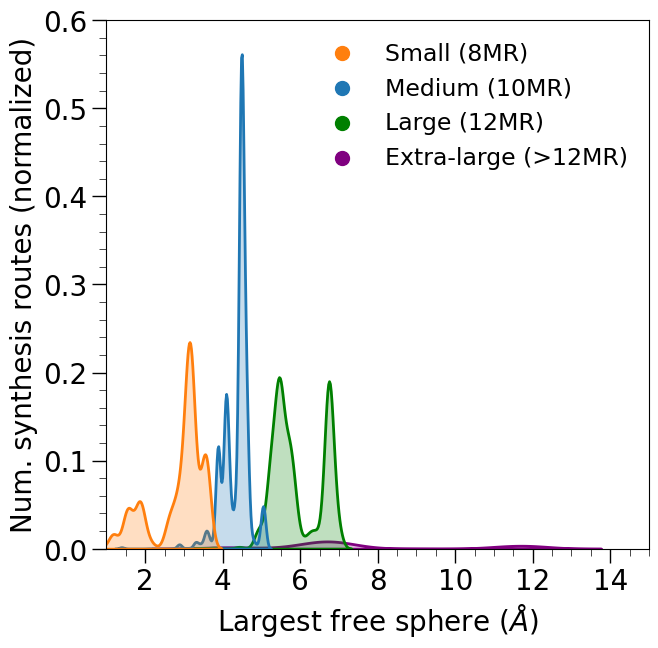

In [16]:
plt.figure(figsize = (7,7), dpi = 100)
sns.kdeplot(data=df, x="largest_free_sphere", hue="pore_type", 
            hue_order=['Small', 'Medium', 'Large', 'Extra-large'] , 
            palette=[s_pore_c, m_pore_c, l_pore_c, xl_pore_c],
#             bw_adjust = 1.5,
            fill = True,
            linewidths=2,
            
            legend=False)

# plt.yscale('log')
plt.xlabel('Largest free sphere ($\AA$)', fontsize = 20)
plt.ylabel('Num. synthesis routes (normalized)', fontsize = 20)

# Create legend
handles = [plt.scatter([], [], s = 100, color=s_pore_c,  label='Small (8MR)'),
           plt.scatter([], [], s = 100, color=m_pore_c,  label='Medium (10MR)'),
           plt.scatter([], [], s = 100, color=l_pore_c,  label='Large (12MR)'),
           plt.scatter([], [], s = 100, color=xl_pore_c, label='Extra-large (>12MR)'),
          ]
labels = [handle.get_label() for handle in handles]
plt.legend(handles=handles, labels=labels, fontsize = 17, frameon=0)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)


plt.xlim(1,15)
plt.ylim(0,0.6)

plt.show()

# Zeotype distribution

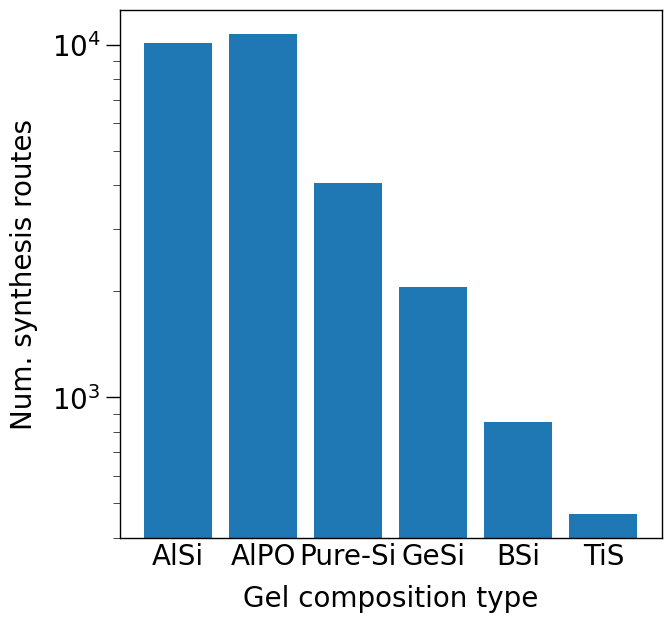

In [17]:
Si = df[(df['Si'] != 0) \
        & (df['Al'] == 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]

SiAl = df[(df['Si'] != 0) \
        & (df['Al'] != 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]
SiGe = df[
          (df['Si'] != 0) \
#         & (df['Al'] == 0) \
#         & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge'] != 0) \
         ]
SiB = df[(df['Si'] != 0) \
#         & (df['Al'] == 0) \
#         & (df['P']  == 0) \
        & (df['B']  != 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]
AlP = df[
#            (df['Si'] != 0) \ # Not sure whether I should apply Si == 0?
         (df['Al'] != 0) \
        & (df['P']  != 0) \
#         & (df['B']  == 0) \
#         & (df['Ti']  == 0) \
#         & (df['Ge']  == 0) \
         ]

SiT = df[(df['Si'] != 0) \
        & (df['Al'] == 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  != 0) \
        & (df['Ge']  == 0) \
         ]

fig, ax = plt.subplots(figsize=(7,7), dpi = 100)

plt.bar(x=['AlSi', 'AlPO', 'Pure-Si','GeSi', 'BSi', 'TiS'], height=[len(SiAl), len(AlP), len(Si), len(SiGe), len(SiB), len(SiT)])
plt.xlabel('Gel composition type', fontsize=20, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=20, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=0, width=0)

plt.show()

In [18]:
len(Si)+len(SiAl)+len(SiGe)+len(SiB)+len(AlP)

27872

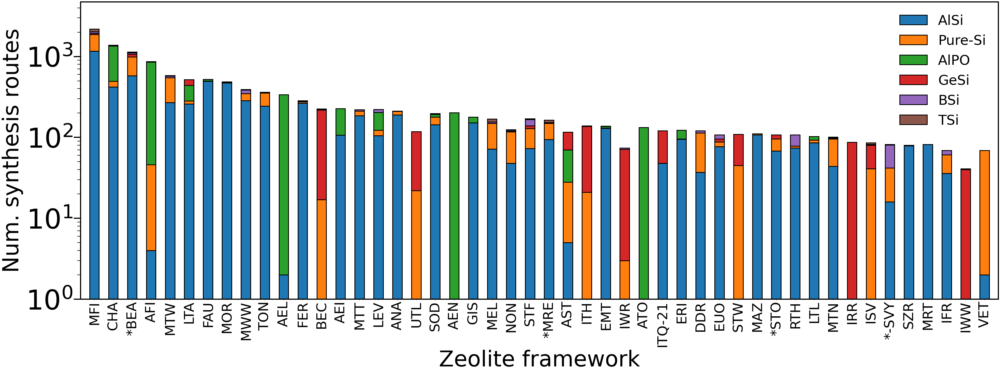

In [19]:
n_frameworks = 50
zeos_value_counts = df['Code1'].value_counts()[:n_frameworks]
zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]

fig, ax = plt.subplots(figsize=(60,20))

        
# Create a dictionary of lists, each with len(zeo_value_counts). Each element of this list is the number of zeotypes for a framework
zeotype_counts = {
         'AlSi':    [len(SiAl[SiAl['Code1'] == z]) for z in zeos_value_counts.index], 
         'Pure-Si': [len(Si[Si['Code1'] == z]) for z in zeos_value_counts.index], 
         'AlPO':    [len(AlP[AlP['Code1'] == z]) for z in zeos_value_counts.index], 
         'GeSi':    [len(SiGe[SiGe['Code1'] == z]) for z in zeos_value_counts.index], 
         'BSi':     [len(SiB[SiB['Code1'] == z]) for z in zeos_value_counts.index],
         'TSi':     [len(SiT[SiT['Code1'] == z]) for z in zeos_value_counts.index],
                 }

# Initialize bottom anchor (to be added onto)
bottom = np.zeros(len(zeos_value_counts))

for zeotype, zeotype_count in zeotype_counts.items():
    p = ax.bar(zeos_value_counts.index, zeotype_count, 0.5, label=zeotype, bottom=bottom, edgecolor='black', linewidth=3)
    bottom += zeotype_count


# # zeos_value_counts.plot(kind = 'bar', weight_count = weight_count, color = colors, edgecolor='black', linewidth=3)
# ax.bar(zeos_value_counts.index, zeos_value_counts, weight_count)
# ax.bar(species, weight_count, width, label=boolean, bottom=bottom)

plt.xlabel('Zeolite framework', fontsize=80, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=80, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=50)
plt.yticks(fontsize=100) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(4)    # Top axis line
ax.spines['right'].set_linewidth(4)  # Right axis line
ax.spines['bottom'].set_linewidth(4) # Bottom axis line
ax.spines['left'].set_linewidth(4)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=25, width=4)
plt.tick_params(axis='y', which='minor', length=12.5, width=2)

plt.xticks(rotation = 90)

plt.margins(0.01, 0.1)

# # Create legend
# handles = [plt.scatter([], [], s = 2000, color=s_pore_c,  label='Small (8MR)'),
#            plt.scatter([], [], s = 2000, color=m_pore_c,  label='Medium (10MR)'),
#            plt.scatter([], [], s = 2000, color=l_pore_c,  label='Large (12MR)'),
#            plt.scatter([], [], s = 2000, color=xl_pore_c, label='Extra-large (>12MR)'),
#           ]
# labels = [handle.get_label() for handle in handles]
# plt.legend(handles=handles, labels=labels, fontsize = 70, frameon=0)

plt.legend(fontsize = 50, frameon = 0, loc = 'upper right')

plt.show()

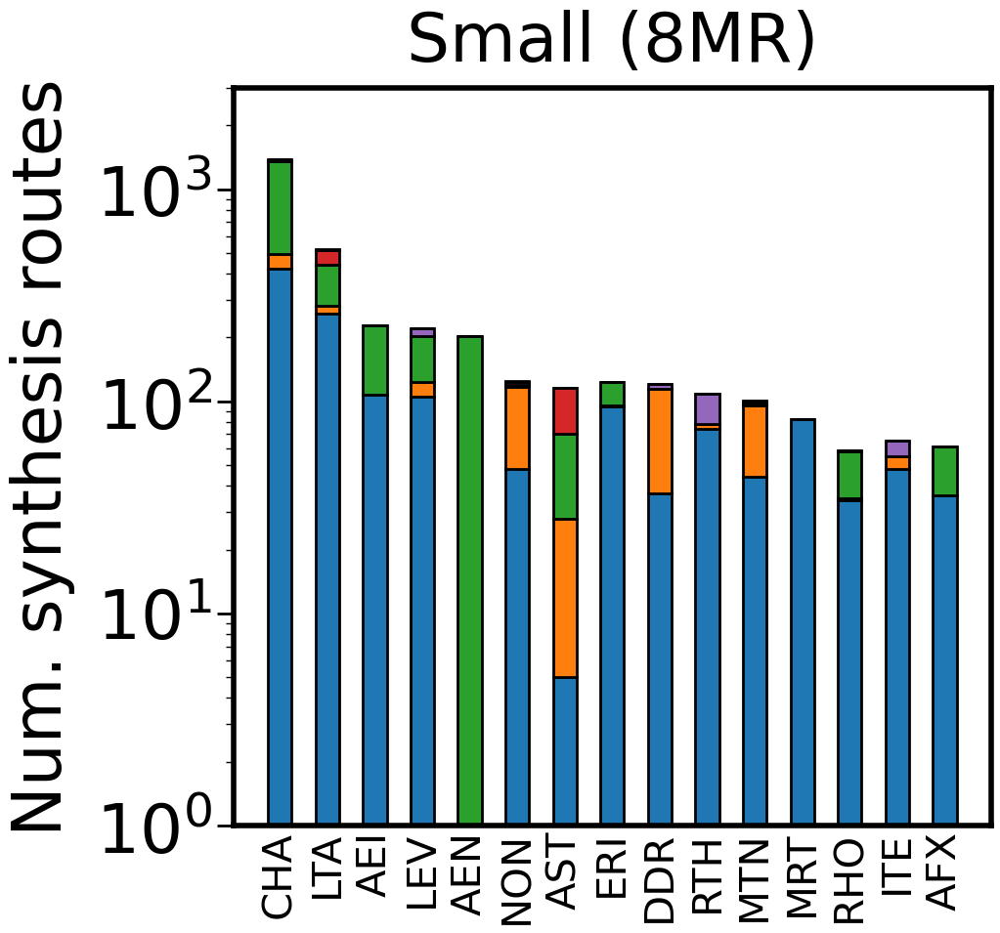

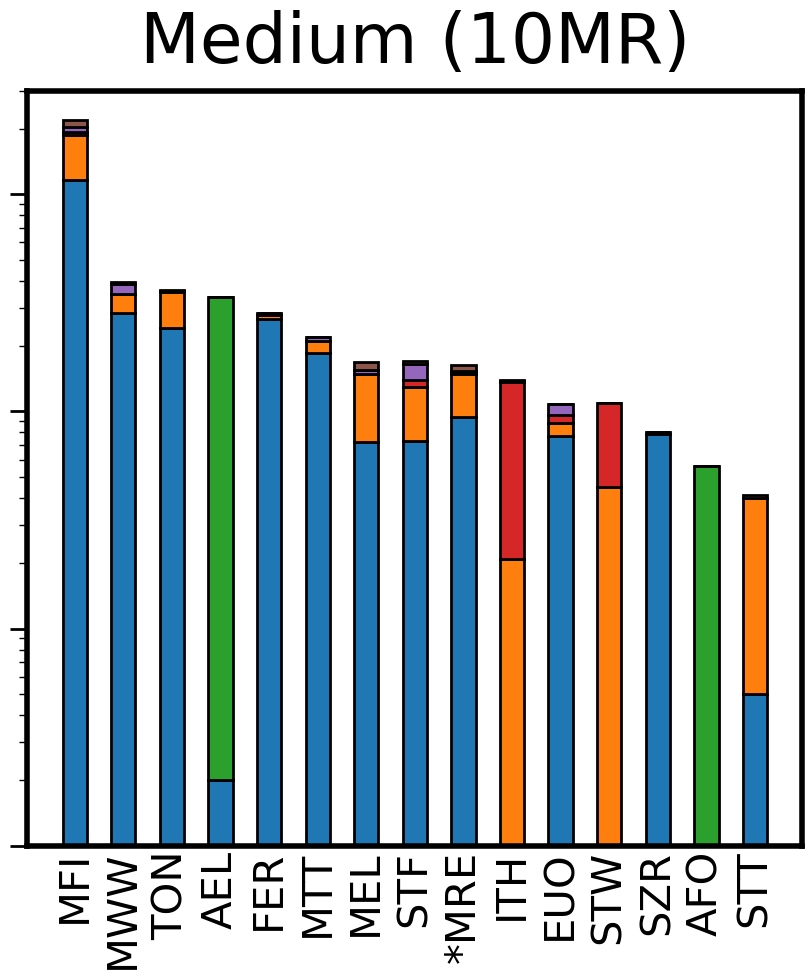

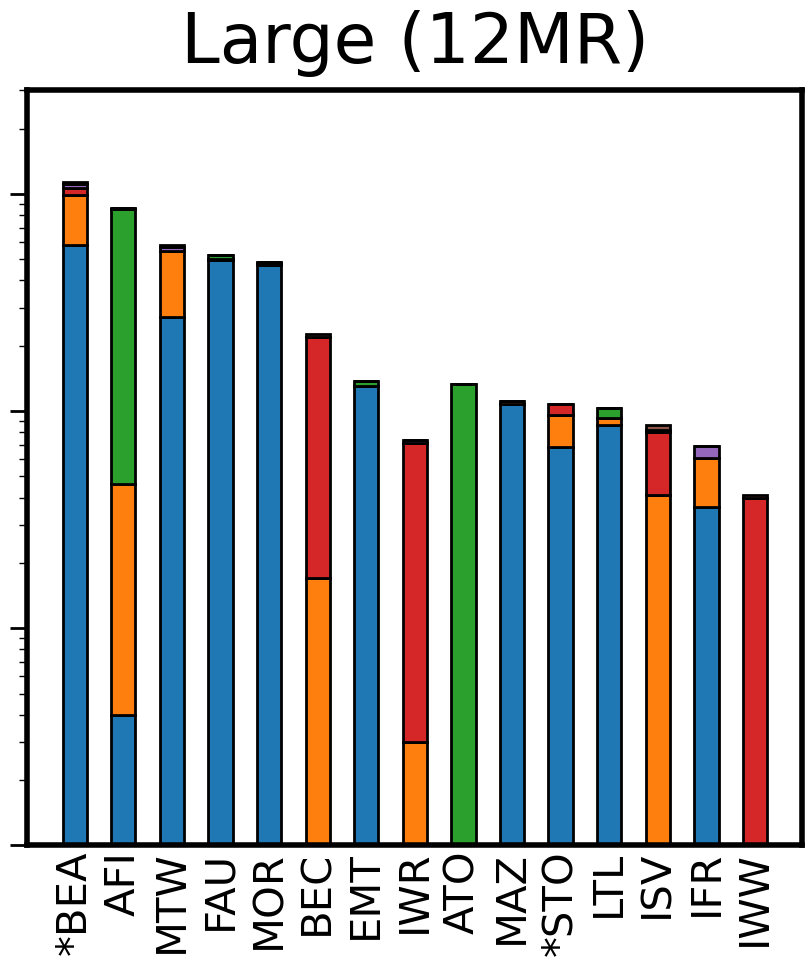

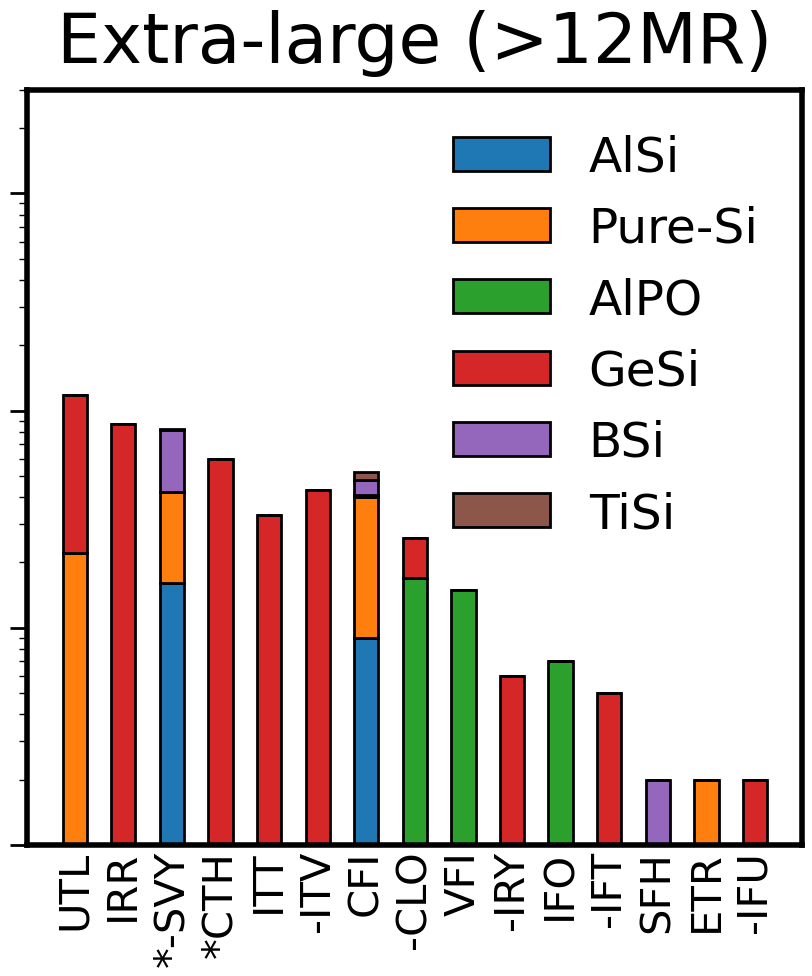

In [20]:
# By pore

for pore_name, p in zip(['Small (8MR)', 'Medium (10MR)', 'Large (12MR)', 'Extra-large (>12MR)'], [s_pore, m_pore, l_pore, xl_pore]):
    
    if pore_name == 'Small (8MR)':
        n_frameworks = 18 # To remove dense phases ANA, SOD, GIS
    else:
        n_frameworks = 15
    
    zeos_value_counts = df['Code1'].value_counts()
    zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]
    zeos_value_counts_pore = zeos_value_counts[zeos_value_counts.index.isin(p)][:n_frameworks]
    
    if pore_name == 'Small (8MR)': # To remove dense phases ANA, SOD, GIS
        zeos_value_counts_pore = zeos_value_counts_pore.drop(index = ['ANA', 'SOD', 'GIS'])

    fig, ax = plt.subplots(figsize=(10,10), dpi = 100)

    # Create a dictionary of lists, each with len(zeo_value_counts). Each element of this list is the number of zeotypes for a framework
    zeotype_counts = {
             'AlSi':    [len(SiAl[SiAl['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'Pure-Si': [len(Si[Si['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'AlPO':    [len(AlP[AlP['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'GeSi':    [len(SiGe[SiGe['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'BSi':     [len(SiB[SiB['Code1'] == z]) for z in zeos_value_counts_pore.index],
             'TiSi':     [len(SiT[SiT['Code1'] == z]) for z in zeos_value_counts_pore.index],
                     }

    # Initialize bottom anchor (to be added onto)
    bottom = np.zeros(len(zeos_value_counts_pore))

    for zeotype, zeotype_count in zeotype_counts.items():
        p = ax.bar(zeos_value_counts_pore.index, zeotype_count, 0.5, label=zeotype, bottom=bottom, edgecolor='black', linewidth=2)
        bottom += zeotype_count

#     plt.xlabel('Zeolite framework', fontsize=40, labelpad=15)
    if pore_name == 'Small (8MR)':
        plt.ylabel('Num. synthesis routes', fontsize=50, labelpad=15)
    ax.set_yscale('log')
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=50) 

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(4)    # Top axis line
    ax.spines['right'].set_linewidth(4)  # Right axis line
    ax.spines['bottom'].set_linewidth(4) # Bottom axis line
    ax.spines['left'].set_linewidth(4)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=12.5, width=2)
    plt.tick_params(axis='y', which='minor', length=6, width=1)
    plt.tick_params(axis='x', which='major', length=0, width=1)
    plt.tick_params(axis='x', which='minor', length=0, width=1)
    
    if pore_name != 'Small (8MR)':
        plt.tick_params(labelleft = False)

    plt.xticks(rotation = 90)

#     plt.margins(0.01, 0.1)

    # # Create legend
    # handles = [plt.scatter([], [], s = 2000, color=s_pore_c,  label='Small (8MR)'),
    #            plt.scatter([], [], s = 2000, color=m_pore_c,  label='Medium (10MR)'),
    #            plt.scatter([], [], s = 2000, color=l_pore_c,  label='Large (12MR)'),
    #            plt.scatter([], [], s = 2000, color=xl_pore_c, label='Extra-large (>12MR)'),
    #           ]
    # labels = [handle.get_label() for handle in handles]
    # plt.legend(handles=handles, labels=labels, fontsize = 70, frameon=0)

    if pore_name == 'Extra-large (>12MR)':
        plt.legend(fontsize = 35, frameon = 0, loc = 'upper right')
    plt.title(pore_name, fontsize = 50, pad=20)
    
    plt.ylim(1,3000)

    plt.show()

# Pore type vs time

In [21]:
s_pore_years, m_pore_years, l_pore_years, xl_pore_years             = [], [], [], []
s_pore_num_syns, m_pore_num_syns, l_pore_num_syns, xl_pore_num_syns = [], [], [], []

s_pore_num_syn, m_pore_num_syn, l_pore_num_syn, xl_pore_num_syn = 0, 0, 0, 0
for year in np.arange(1966, 2020):
    
    for y, data in df_s_pore.groupby('year'):
        if y == year:
            s_pore_num_syn += len(data)
            s_pore_years.append(year), s_pore_num_syns.append(s_pore_num_syn)
            
    for y, data in df_m_pore.groupby('year'):
        if y == year:
            m_pore_num_syn += len(data)
            m_pore_years.append(year), m_pore_num_syns.append(m_pore_num_syn)
            
    for y, data in df_l_pore.groupby('year'):
        if y == year:
            l_pore_num_syn += len(data)
            l_pore_years.append(year), l_pore_num_syns.append(l_pore_num_syn)
    
    for y, data in df_xl_pore.groupby('year'):
        if y == year:
            xl_pore_num_syn += len(data)
            xl_pore_years.append(year), xl_pore_num_syns.append(xl_pore_num_syn)
            

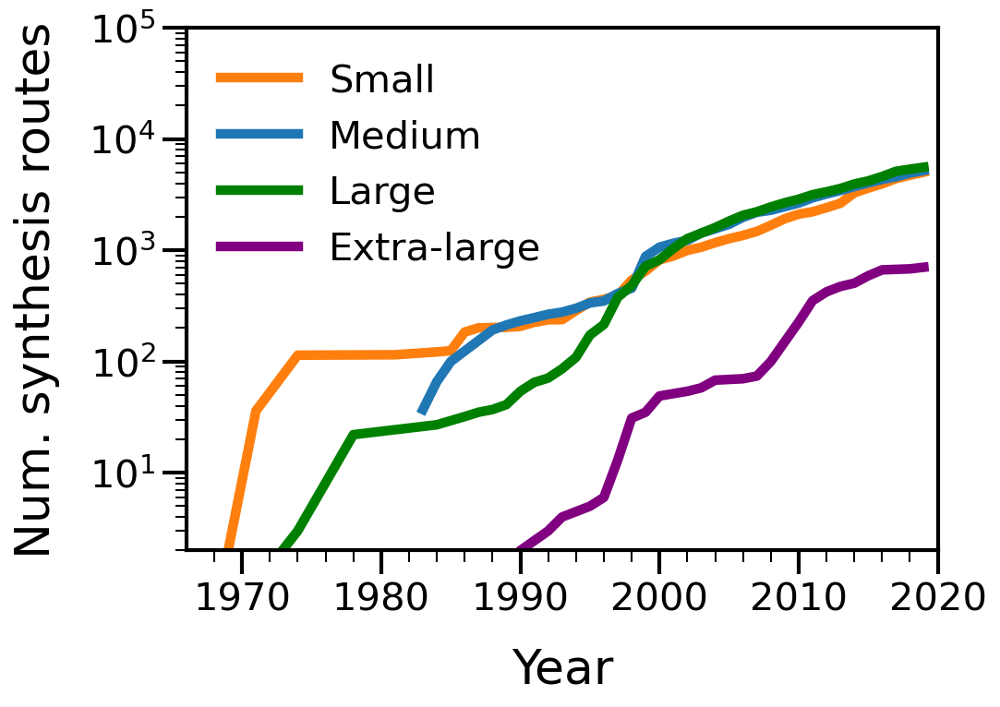

In [22]:
lw = 5
fig, ax = plt.subplots(figsize=(7,5), dpi = 150)
plt.plot(s_pore_years, s_pore_num_syns, label = 'Small', linewidth = lw, c = s_pore_c)
plt.plot(m_pore_years, m_pore_num_syns, label = 'Medium', linewidth = lw, c = m_pore_c)
plt.plot(l_pore_years, l_pore_num_syns, label = 'Large', linewidth = lw, c = l_pore_c)
plt.plot(xl_pore_years, xl_pore_num_syns, label = 'Extra-large', linewidth = lw, c = xl_pore_c)
plt.yscale('log')

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=12.5, width=2)
plt.tick_params(axis='y', which='minor', length=6, width=1)
plt.tick_params(axis='x', which='major', length=12.5, width=2)
plt.tick_params(axis='x', which='minor', length=6, width=1)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

plt.xlabel('Year', fontsize=25, labelpad=15)
plt.ylabel('Num. synthesis routes', fontsize=25, labelpad=15)

plt.legend(fontsize = 20, frameon = 0)
plt.ylim(2,1e5)
plt.xlim(1966,2020)
plt.show()

# Gel composition distributions

In [23]:
def adjacent_values(vals, q1, q3):
    upper_adjacent_value = q3 + (q3 - q1) * 1.5
    upper_adjacent_value = np.clip(upper_adjacent_value, q3, vals[-1])

    lower_adjacent_value = q1 - (q3 - q1) * 1.5
    lower_adjacent_value = np.clip(lower_adjacent_value, vals[0], q1)
    return lower_adjacent_value, upper_adjacent_value

SiAl_ratio = df['Si']/df['Al']
SiAl_ratio = SiAl_ratio[(~SiAl_ratio.isna()) & (SiAl_ratio > 0.)]
SiAl_ratio.replace([np.inf], np.nan, inplace=True)
SiAl_ratio.dropna(inplace=True)
SiAl_ratio = np.array(SiAl_ratio)

SiGe_ratio = df['Si']/df['Ge']
SiGe_ratio = SiGe_ratio[(~SiGe_ratio.isna()) & (SiGe_ratio > 0.)]
SiGe_ratio.replace([np.inf], np.nan, inplace=True)
SiGe_ratio.dropna(inplace=True)
SiGe_ratio = np.array(SiGe_ratio)

SiB_ratio = df['Si']/df['B']
SiB_ratio = SiB_ratio[(~SiB_ratio.isna()) & (SiB_ratio > 0.)]
SiB_ratio.replace([np.inf], np.nan, inplace=True)
SiB_ratio.dropna(inplace=True)
SiB_ratio = np.array(SiB_ratio)

SiTi_ratio = df['Si']/df['Ti']
SiTi_ratio = SiTi_ratio[(~SiTi_ratio.isna()) & (SiTi_ratio > 0.)]
SiTi_ratio.replace([np.inf], np.nan, inplace=True)
SiTi_ratio.dropna(inplace=True)
SiTi_ratio = np.array(SiTi_ratio)

AlP_ratio = df['Al']/df['P']
AlP_ratio = AlP_ratio[(~AlP_ratio.isna()) & (AlP_ratio > 0.)]
AlP_ratio.replace([np.inf], np.nan, inplace=True)
AlP_ratio.dropna(inplace=True)
AlP_ratio = np.array(AlP_ratio)

OHT_ratio = df['OH']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
OHT_ratio = OHT_ratio[(~OHT_ratio.isna()) & (OHT_ratio > 0.)]
OHT_ratio.replace([np.inf], np.nan, inplace=True)
OHT_ratio.dropna(inplace=True)
OHT_ratio = np.array(OHT_ratio)

FT_ratio = df['F']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
FT_ratio = FT_ratio[(~FT_ratio.isna()) & (FT_ratio > 0.)]
FT_ratio.replace([np.inf], np.nan, inplace=True)
FT_ratio.dropna(inplace=True)
FT_ratio = np.array(FT_ratio)

LiT_ratio = df['Li']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
LiT_ratio = LiT_ratio[(~LiT_ratio.isna()) & (LiT_ratio > 0.)]
LiT_ratio.replace([np.inf], np.nan, inplace=True)
LiT_ratio.dropna(inplace=True)
LiT_ratio = np.array(LiT_ratio)

NaT_ratio = df['Na']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
NaT_ratio = NaT_ratio[(~NaT_ratio.isna()) & (NaT_ratio > 0.)]
NaT_ratio.replace([np.inf], np.nan, inplace=True)
NaT_ratio.dropna(inplace=True)
NaT_ratio = np.array(NaT_ratio)

KT_ratio = df['K']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
KT_ratio = KT_ratio[(~KT_ratio.isna()) & (KT_ratio > 0.)]
KT_ratio.replace([np.inf], np.nan, inplace=True)
KT_ratio.dropna(inplace=True)
KT_ratio = np.array(KT_ratio)

OSDAT_ratio = df['sda1']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
OSDAT_ratio = OSDAT_ratio[(~OSDAT_ratio.isna()) & (OSDAT_ratio > 0.)]
OSDAT_ratio.replace([np.inf], np.nan, inplace=True)
OSDAT_ratio.dropna(inplace=True)
OSDAT_ratio = np.array(OSDAT_ratio)

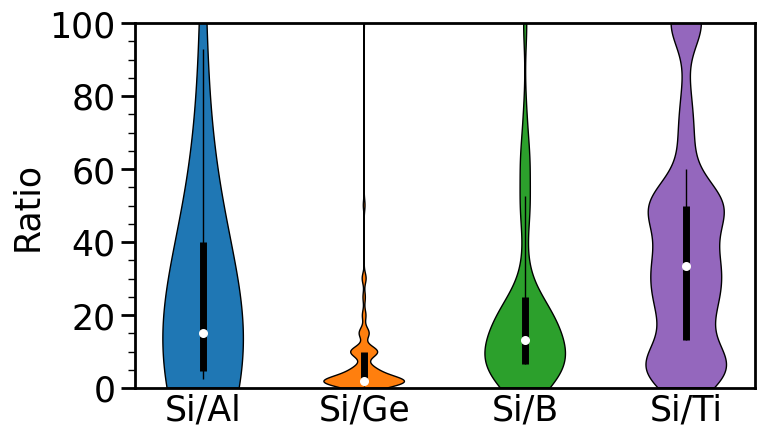

In [24]:
# Data
data     = [SiAl_ratio, SiGe_ratio, SiB_ratio, SiTi_ratio]
x_labels = ['Si/Al', 'Si/Ge', 'Si/B', 'Si/Ti']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=5000,
        bw_method=0.125,
)

colors = ['tab:blue', 'tab:orange', 'tab:green','tab:purple']
for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,100)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

plt.ylabel('Ratio', fontsize = 25)

plt.show()

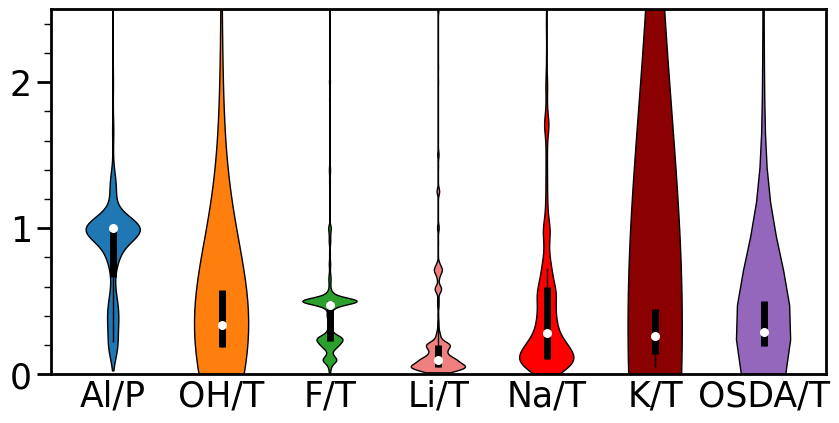

In [25]:
# Data
data     = [AlP_ratio, OHT_ratio, FT_ratio, LiT_ratio, NaT_ratio, KT_ratio, OSDAT_ratio]
x_labels = ['Al/P', 'OH/T', 'F/T', 'Li/T', 'Na/T', 'K/T', 'OSDA/T']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=5000,
        bw_method=0.05,
)

colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']
for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,2.5)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 3, 1.))

plt.show()

# Si/Al ratio of zeolites vs AlPO

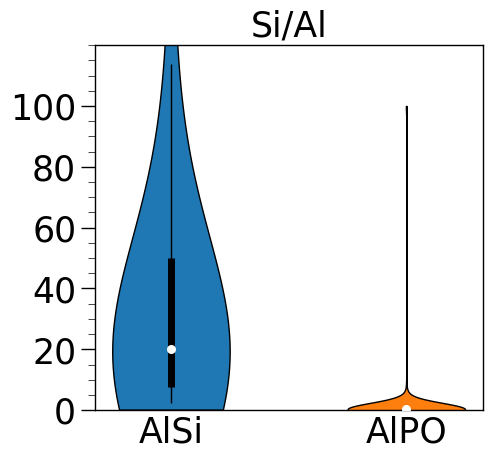

In [26]:
SiAl_ratio = df['Si']/df['Al']
SiAl_ratio = SiAl_ratio[(~SiAl_ratio.isna()) & (SiAl_ratio > 0.)]
SiAl_ratio.replace([np.inf], np.nan, inplace=True)
SiAl_ratio.dropna(inplace=True)

# define subsets of data for AlSi and AlPOs
SiAl_ratio_AlSi = np.array(SiAl_ratio.loc[SiAl_ratio.index.isin(SiAl.index)])
SiAl_ratio_AlP = np.array(SiAl_ratio.loc[SiAl_ratio.index.isin(AlP.index)])


# Data
data     = [SiAl_ratio_AlSi, SiAl_ratio_AlP]
x_labels = ['AlSi', 'AlPO']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=5000,
#         bw_method=0.05,
)

colors = ['tab:blue', 'tab:orange']
for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 
plt.title('Si/Al',fontsize=25)

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,120)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 120, 20.))

plt.show()

# Cryst temp w.r.t. zeotype

In [27]:
cryst_temp = df['cryst_temp']
cryst_temp = cryst_temp.apply(lambda x: float(x) if type(x) == int else x) # Int to float
cryst_temp= cryst_temp.apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers
cryst_temp = (cryst_temp[(~cryst_temp.isna())])

cryst_temp_SiAl = list(cryst_temp[cryst_temp.index.isin(SiAl.index)])
cryst_temp_SiGe = list(cryst_temp[cryst_temp.index.isin(SiGe.index)])
cryst_temp_SiB = list(cryst_temp[cryst_temp.index.isin(SiB.index)])
cryst_temp_SiT = list(cryst_temp[cryst_temp.index.isin(SiT.index)])
cryst_temp_AlP = list(cryst_temp[cryst_temp.index.isin(AlP.index)])

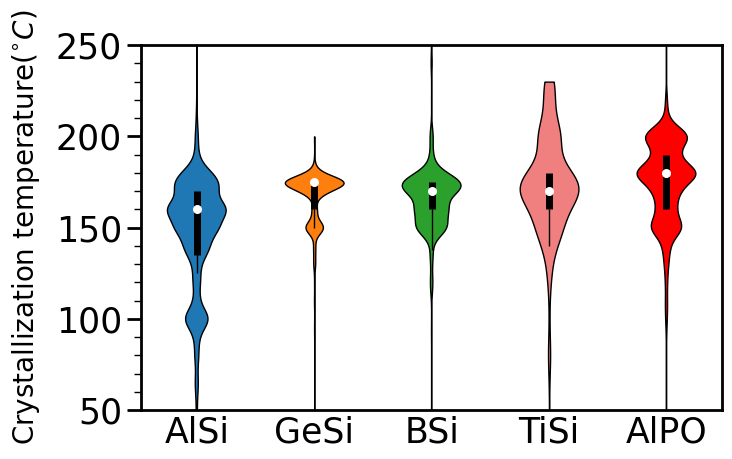

In [28]:
# Data
data     = [cryst_temp_SiAl, cryst_temp_SiGe, cryst_temp_SiB, cryst_temp_SiT, cryst_temp_AlP]
x_labels = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(50,250)

plt.ylabel('Crystallization temperature($^{\circ}C$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(50, 300, 50))

plt.show()

# Element distributions

In [29]:
elem_cols = [
'Si', 'Al', 'P', 'Na', 'K', 'Li',
'Sr', 'Rb', 'Cs', 'Ba', 'Ca', 'F', 'Ge', 'Ti', 'In', 'B', 'Mg', 'Ga', 
'Ni', 'Mn', 'Fe', 'Co', 'Cr', 'Zn', 'Nb', 'Be', 'W', 'Ce', 'Cu', 'Sn', 'Gd', 'La', 'Y', 'Dy', 'Sm', 'Ag', 'Cd', 'Zr', 'V',
'Ta', 'Ru', 'Hf', 'Yb', 'Tl', 'As',
]

elem_freq = {}
freqs = []
for elem in elem_cols:
    freq = np.log10(len(df[(~df[elem].isna()) & (df[elem]>0)]))
    elem_freq[elem] = freq
    
elem_freq

{'Si': 4.304835069229006,
 'Al': 4.187859000340963,
 'P': 3.6848453616444123,
 'Na': 3.9183973388437003,
 'K': 3.361538971269279,
 'Li': 2.7075701760979363,
 'Sr': 2.0043213737826426,
 'Rb': 1.8129133566428555,
 'Cs': 2.5024271199844326,
 'Ba': 1.2787536009528289,
 'Ca': 1.3979400086720377,
 'F': 3.7907072873276797,
 'Ge': 3.481442628502305,
 'Ti': 2.7752462597402365,
 'In': 0.9542425094393249,
 'B': 3.229937685907934,
 'Mg': 2.598790506763115,
 'Ga': 2.5024271199844326,
 'Ni': 1.9084850188786497,
 'Mn': 2.2121876044039577,
 'Fe': 2.6009728956867484,
 'Co': 2.6414741105040993,
 'Cr': 1.6901960800285136,
 'Zn': 2.660865478003869,
 'Nb': 0.9030899869919435,
 'Be': 1.3979400086720377,
 'W': 0.47712125471966244,
 'Ce': 1.5185139398778875,
 'Cu': 2.113943352306837,
 'Sn': 1.9731278535996986,
 'Gd': 0.6989700043360189,
 'La': 1.1139433523068367,
 'Y': 0.0,
 'Dy': 0.0,
 'Sm': 0.3010299956639812,
 'Ag': 0.47712125471966244,
 'Cd': 0.3010299956639812,
 'Zr': 1.3979400086720377,
 'V': 2.50105926

/home/jupyter/Elton/Zeolites/ZeoSyn_dataset_paper/s4/ml/plotting.py:182: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("coolwarm").copy()
  cbar.cmap.set_under(blank_color)


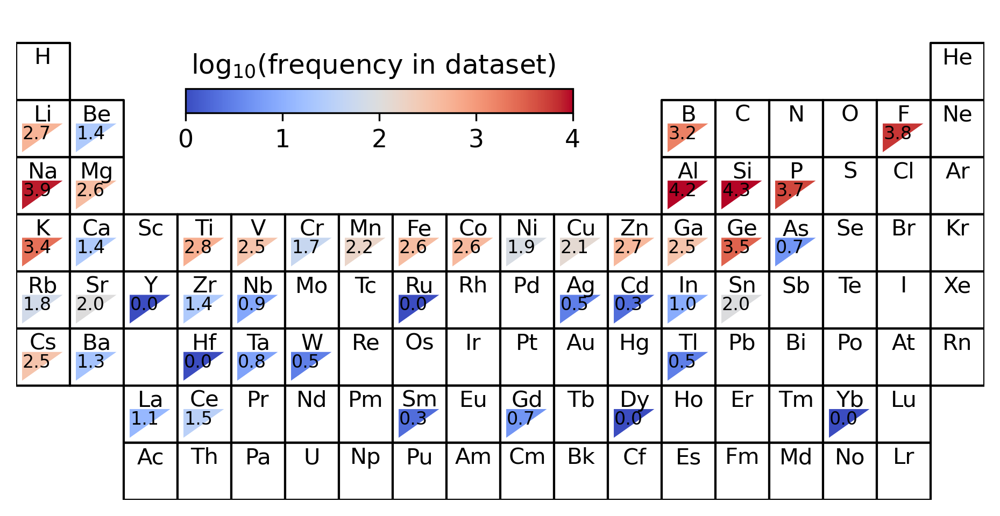

In [30]:
# Citation: https://pubs.acs.org/doi/full/10.1021/acs.chemmater.2c01293 
# Source code: https://github.com/CederGroupHub/s4/blob/master/s4/ml/plotting.py

fig = plt.figure(figsize=(6, 3), dpi=300)

# ax1_pt = fig.add_axes([0.28, 0.52, 0.70, 0.50])
ax1_pt = fig.add_axes([0., 0., 1., 1.])
# ax2_pt = fig.add_axes([0.28, 0.01, 0.70, 0.50])

ax1_cbar = fig.add_axes([0.175, 0.8, 0.4, 0.05])
# ax2_cbar = fig.add_axes([0.40, 0.395, 0.30, 0.018])

periodic_table_heatmap_sbs(
    {x.split('[')[0].split('_')[-1]: y
     for x, y in elem_freq.items() 
    },
    {x.split('[')[0].split('_')[-1]: y
     for x, y in {}.items() 
     },
    cmap='coolwarm',
    cax=ax1_cbar,
    cbar_label_size=11,
    value_format='\n%.1f',
    include_rows={1,2,3,4,5,6,8,9},
    ax=ax1_pt,
    pt_label_fontsize=10,
    pt_value_fontsize=8,
    cmap_range=(0, 4),
)
ax1_pt.text(3.25, 0.8, 'log$_{10}$(frequency in dataset)', fontsize=12)

ax_labels = fig.add_axes([0, 0, 1, 1])
ax_labels.patch.set_alpha(0.0)
ax_labels.set_xlim([0, 1])
ax_labels.set_ylim([0, 1])
ax_labels.set_xticks([])
ax_labels.set_yticks([])
[v.set_visible(False) for v in ax_labels.spines.values()]

# plt.tight_layout()
# plt.savefig('figures/element_frequency.png')
plt.show()

In [31]:
for elem in elem_cols:
    print('Element:', elem)
    print(df[(~df[elem].isna()) & (df[elem]>0)]['doi'])

    print()

Element: Si
0        10.1002/1521-3765(20021004)8:19<4549::aid-chem...
1        10.1002/1521-3765(20021004)8:19<4549::aid-chem...
2        10.1002/1521-3765(20021004)8:19<4549::aid-chem...
3        10.1002/1521-3765(20021004)8:19<4549::aid-chem...
5                                   10.1002/anie.200250076
                               ...                        
30159                                    10.1021/ja990722u
30160                                    10.1021/ja990722u
30161                                    10.1021/ja990722u
30162                                    10.1021/ja990722u
30163                                    10.1021/ja990722u
Name: doi, Length: 20176, dtype: object

Element: Al
5        10.1002/anie.200250076
6        10.1002/anie.200250076
8        10.1002/anie.200250351
79       10.1002/anie.200704003
80       10.1002/anie.200704003
                  ...          
30159         10.1021/ja990722u
30160         10.1021/ja990722u
30161         10.1021/ja990722

88              10.1002/anie.200905214
536             10.1002/chem.201701742
537             10.1002/chem.201701742
538             10.1002/chem.201701742
539             10.1002/chem.201701742
                     ...              
26550    10.1016/s1387-1811(99)00029-3
26551    10.1016/s1387-1811(99)00029-3
26552    10.1016/s1387-1811(99)00029-3
26553    10.1016/s1387-1811(99)00029-3
28343                 10.1039/a909249h
Name: doi, Length: 399, dtype: object

Element: Co
84          10.1002/anie.200803578
85          10.1002/anie.200803578
379         10.1002/chem.200500858
819      10.1007/s10562-005-2128-2
822      10.1007/s10562-005-2128-2
                   ...            
29213            10.1021/ic201515z
29214            10.1021/ic201515z
29215            10.1021/ic201515z
29216            10.1021/ic201515z
29217            10.1021/ic201515z
Name: doi, Length: 438, dtype: object

Element: Cr
1922     10.1016/j.micromeso.2006.04.008
1923     10.1016/j.micromeso.2006.04.008
19

# Cryst temp w.r.t. pore type

In [32]:
cryst_temp_s_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Small'].index)])
cryst_temp_m_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Medium'].index)])
cryst_temp_l_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Large'].index)])
cryst_temp_xl_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Extra-large'].index)])

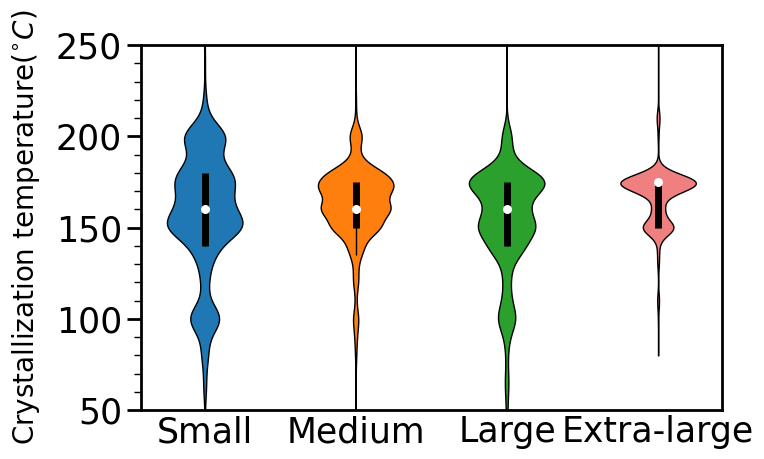

In [33]:
# Data
data     = [cryst_temp_s_pore, cryst_temp_m_pore, cryst_temp_l_pore, cryst_temp_xl_pore]
x_labels = ['Small', 'Medium', 'Large', 'Extra-large']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(50,250)

plt.ylabel('Crystallization temperature($^{\circ}C$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(50, 300, 50))

plt.show()

# Cryst temp w.r.t. framework density

In [34]:
df['cryst_temp'] = df['cryst_temp'].apply(lambda x: float(x) if type(x) == int else x) # Int to float
df['cryst_temp'] = df['cryst_temp'].apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers

cryst_temp_fwd = df[['cryst_temp', 'framework_density', 'Code1']]
cryst_temp_fwd['cryst_temp'] = (cryst_temp_fwd['cryst_temp'][(~cryst_temp_fwd['cryst_temp'].isna())])
cryst_temp_fwd = cryst_temp_fwd.dropna()

/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


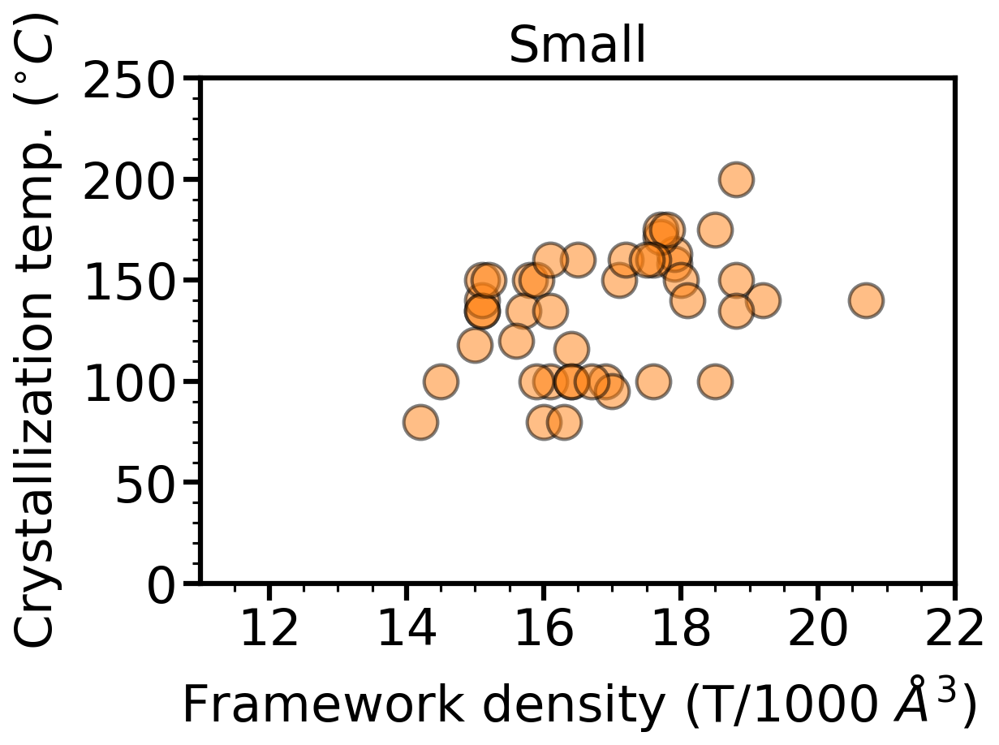

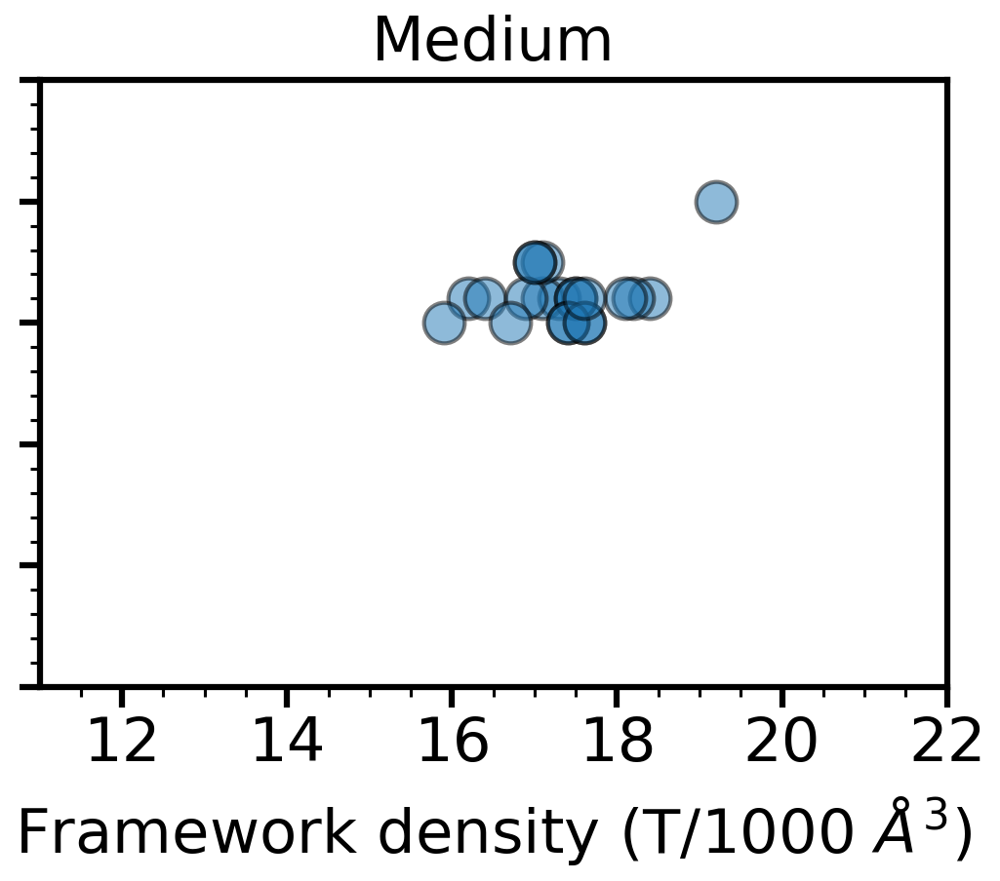

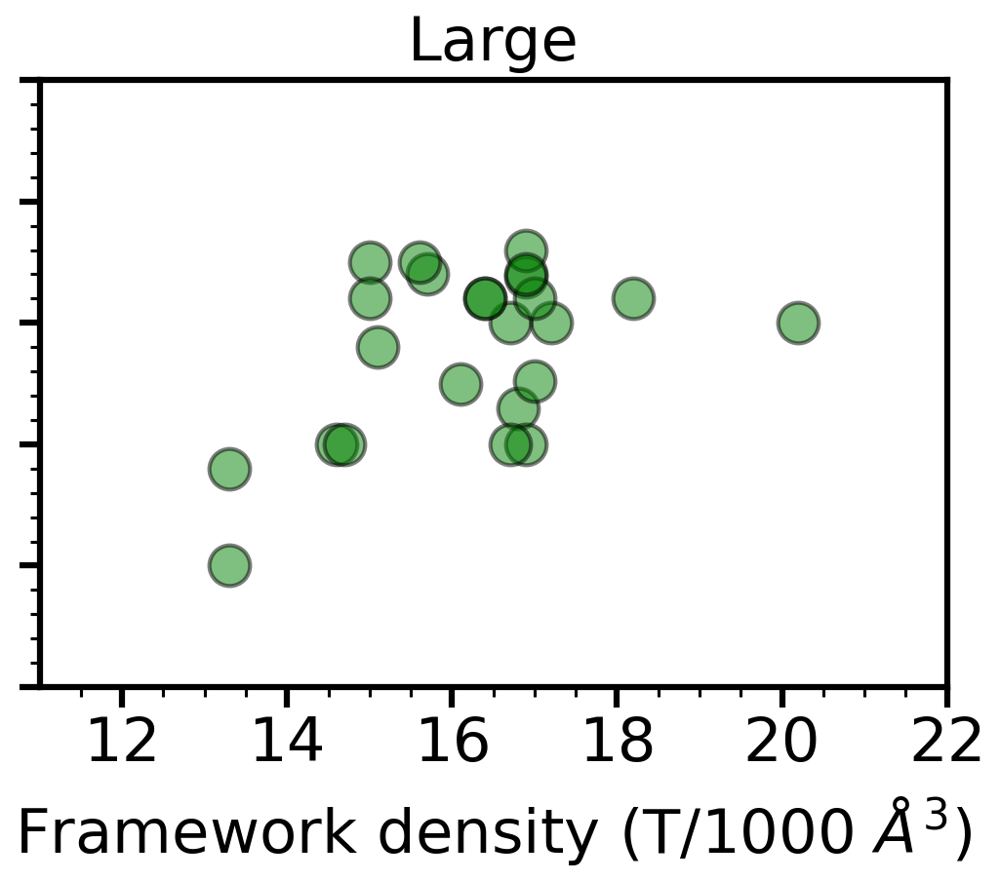

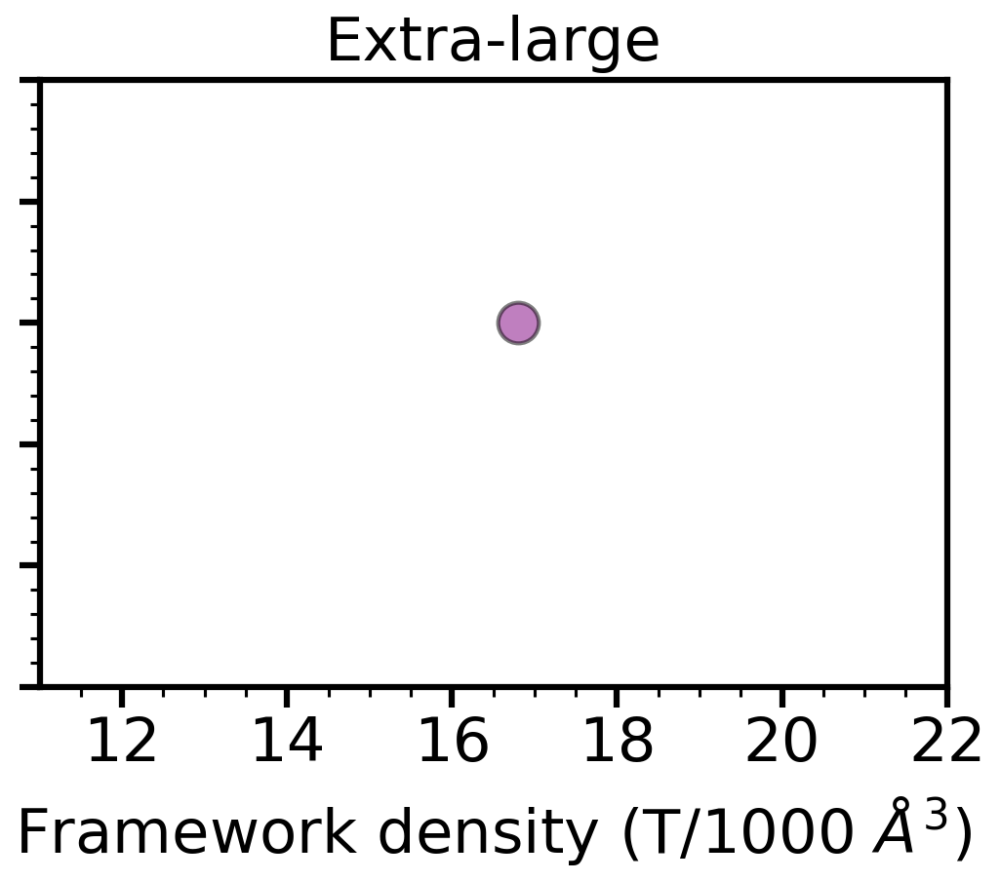

In [35]:
fwds = []
cryst_temps = []
zeos = []

for zeo, data in cryst_temp_fwd[cryst_temp_fwd.index.isin(SiAl.index)].groupby('Code1'):
    
    fwds.append(data['framework_density'].iloc[0]) # take first instance since framework density is the same for all datapoints in grouby
#     cryst_temps.append(data['cryst_temp'].quantile(q=0.1)) # take nth quantile of temperature
    cryst_temps.append(data['cryst_temp'].quantile(q=0.3)) # take nth quantile of temperature
#     cryst_temps.append(data['cryst_temp'].mean()) # take mean value of temperature
    zeos.append(zeo)

cryst_temp_fwd_zeo = pd.DataFrame()
cryst_temp_fwd_zeo['framework_density'],  cryst_temp_fwd_zeo['cryst_temp'], cryst_temp_fwd_zeo['Code1'] = fwds, cryst_temps, zeos


for pore, color, pore_name in zip([s_pore, m_pore, l_pore, xl_pore], [s_pore_c, m_pore_c, l_pore_c, xl_pore_c], ['Small', 'Medium', 'Large', 'Extra-large']):
    data = cryst_temp_fwd_zeo[cryst_temp_fwd_zeo['Code1'].isin(pore)]
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5.5), dpi = 150)

    plt.scatter(data['framework_density'], data['cryst_temp'], s = 400, alpha = 0.5, color = color, edgecolor = 'black', linewidth = 2)

    plt.yticks(fontsize=30) 
    plt.xticks(fontsize=30) 

    plt.ylabel('Crystallization temp. ($^{\circ}C$)', fontsize=30, labelpad=10)
    plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=30, labelpad=10)
    plt.title('{}'.format(pore_name), fontsize = 30, pad = 10)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(3)    # Top axis line
    ax.spines['right'].set_linewidth(3)  # Right axis line
    ax.spines['bottom'].set_linewidth(3) # Bottom axis line
    ax.spines['left'].set_linewidth(3)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=3)
    plt.tick_params(axis='y', which='minor', length=5, width=1.5)
    plt.tick_params(axis='x', which='major', length=10, width=3)
    plt.tick_params(axis='x', which='minor', length=5, width=1.5)

    plt.xlim(11,22)
    plt.ylim(50,220)
    
    plt.yticks(np.arange(0, 300, 50.))
    
    if pore_name != 'Small':
        plt.ylabel('')
        plt.tick_params(labelleft = False)

    plt.show()

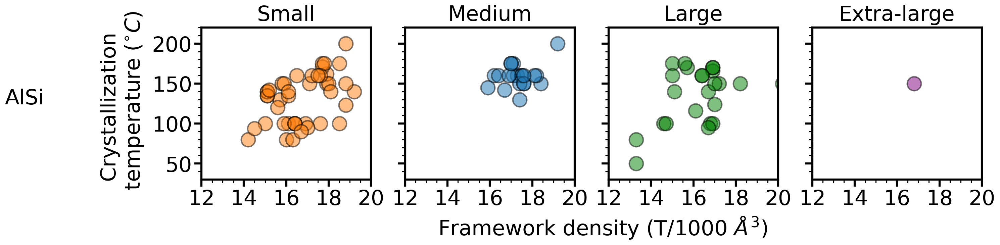

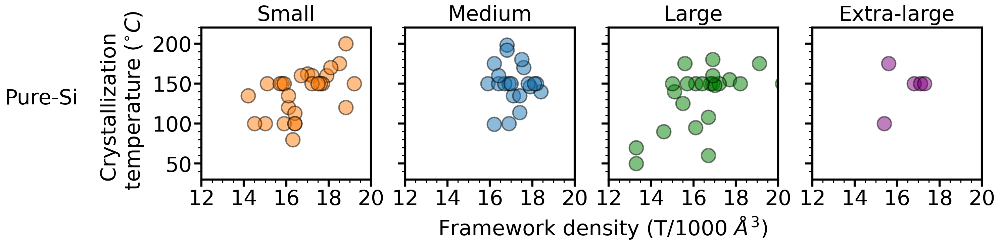

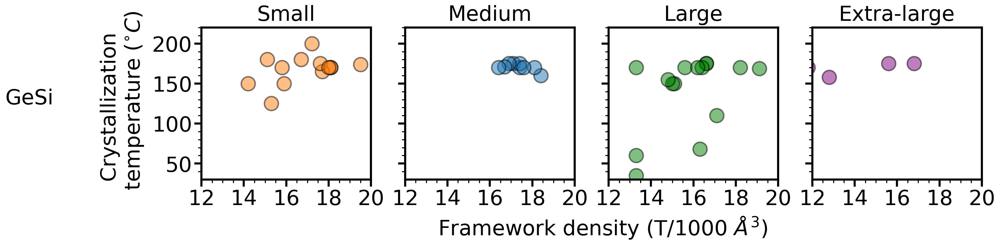

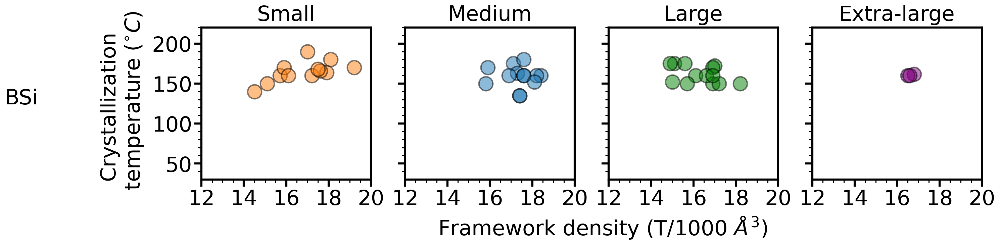

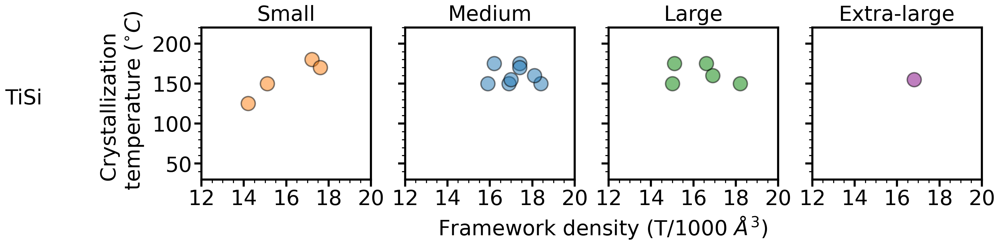

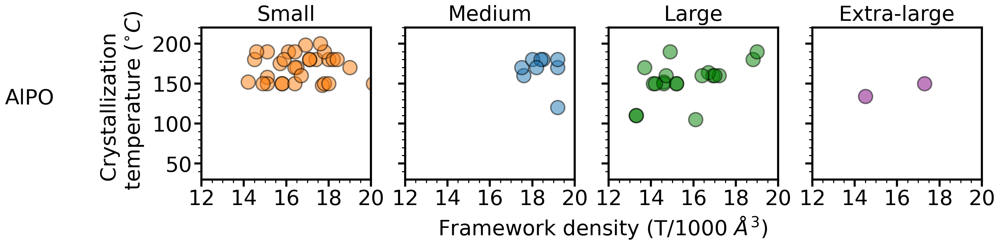

In [36]:
quantile = 0.2 # quantile for taking temperature for a framework

for zeotype, zeotype_name in zip([SiAl, 
                                  Si, 
                                  SiGe, 
                                  SiB, 
                                  SiT, 
                                  AlP], 
                                 ['AlSi', 
                                  'Pure-Si', 
                                  'GeSi', 
                                  'BSi', 
                                  'TiSi', 
                                  'AlPO']
                                ):
    
    fwds = []
    cryst_temps = []
    zeos = []

    for zeo, data in cryst_temp_fwd[cryst_temp_fwd.index.isin(zeotype.index)].groupby('Code1'):

        fwds.append(data['framework_density'].iloc[0]) # take first instance since framework density is the same for all datapoints in grouby
        cryst_temps.append(data['cryst_temp'].quantile(q=quantile)) # take nth quantile of temperature
        zeos.append(zeo)

    cryst_temp_fwd_zeo = pd.DataFrame()
    cryst_temp_fwd_zeo['framework_density'],  cryst_temp_fwd_zeo['cryst_temp'], cryst_temp_fwd_zeo['Code1'] = fwds, cryst_temps, zeos

    fig = plt.figure(figsize=(20, 4), dpi = 150)

    for idx, pore, color, pore_name in zip([1,2,3,4], [s_pore, m_pore, l_pore, xl_pore], [s_pore_c, m_pore_c, l_pore_c, xl_pore_c], ['Small', 'Medium', 'Large', 'Extra-large']):
        data = cryst_temp_fwd_zeo[cryst_temp_fwd_zeo['Code1'].isin(pore)]


        fig.add_subplot(1,4,idx)

        plt.scatter(data['framework_density'], data['cryst_temp'], s = 400, alpha = 0.5, color = color, edgecolor = 'black', linewidth = 2)

        plt.yticks(fontsize=30) 
        plt.xticks(fontsize=30) 

        plt.ylabel('Crystallization \n temperature ($^{\circ}C$)', fontsize=30, labelpad=10)
    #     plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=30, labelpad=10)
        plt.title('{}'.format(pore_name), fontsize = 30, pad = 10)

        ax = plt.gca()
        # Set the line thickness of the axes
        ax.spines['top'].set_linewidth(3)    # Top axis line
        ax.spines['right'].set_linewidth(3)  # Right axis line
        ax.spines['bottom'].set_linewidth(3) # Bottom axis line
        ax.spines['left'].set_linewidth(3)   # Left axis line

        # Set the length and size of major/minor tick marks on the y-axis
        plt.minorticks_on()
        plt.tick_params(axis='y', which='major', length=10, width=3)
        plt.tick_params(axis='y', which='minor', length=5, width=1.5)
        plt.tick_params(axis='x', which='major', length=10, width=3)
        plt.tick_params(axis='x', which='minor', length=5, width=1.5)


        plt.yticks(np.arange(0, 300, 50.))
        plt.xticks(np.arange(0, 30, 2.))
        
        plt.xlim(12,20)
        plt.ylim(30,220)

        if pore_name != 'Small':
            plt.ylabel('')
            plt.tick_params(labelleft = False)
    
    plt.gcf().text(-0.07, 0.5, zeotype_name, fontsize=30)
    plt.gcf().text(0.36, -0.15, 'Framework density (T/1000 $\AA^3$)', fontsize=30)

    plt.show()

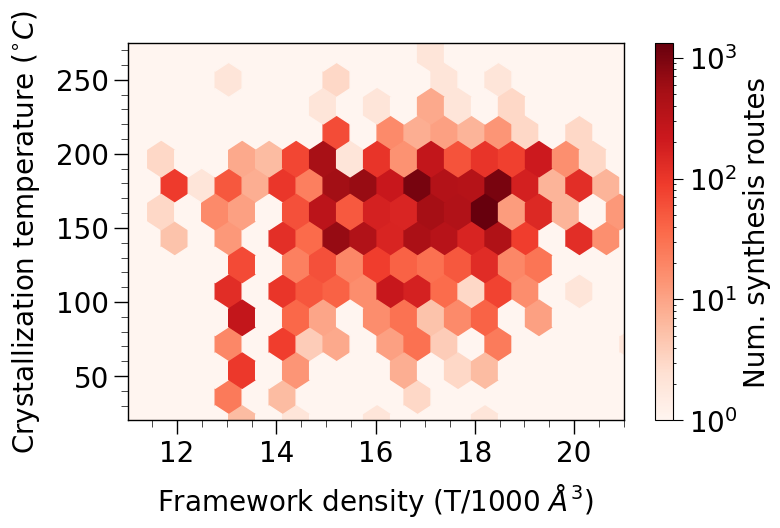

In [37]:
# Aggregated
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

hb = plt.hexbin(x = cryst_temp_fwd['framework_density'] , y= cryst_temp_fwd['cryst_temp'], 
           bins = 'log',
           gridsize = 25,
           cmap = 'Reds')

cb = fig.colorbar(hb, ax=ax)
cb.ax.tick_params(labelsize=20, size=7.5)
cb.set_label('Num. synthesis routes', fontsize = 20)

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(11,21)
plt.ylim(20,275)

plt.show()

In [38]:
len(cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_s_pore.index)]), \
len(cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_m_pore.index)]), \
len(cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_l_pore.index)]), \
len(cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_xl_pore.index)])

(5003, 5186, 4321, 457)

In [39]:
len(df_s_pore), len(df_m_pore), len(df_l_pore), len(df_xl_pore)

(5250, 5494, 5769, 716)

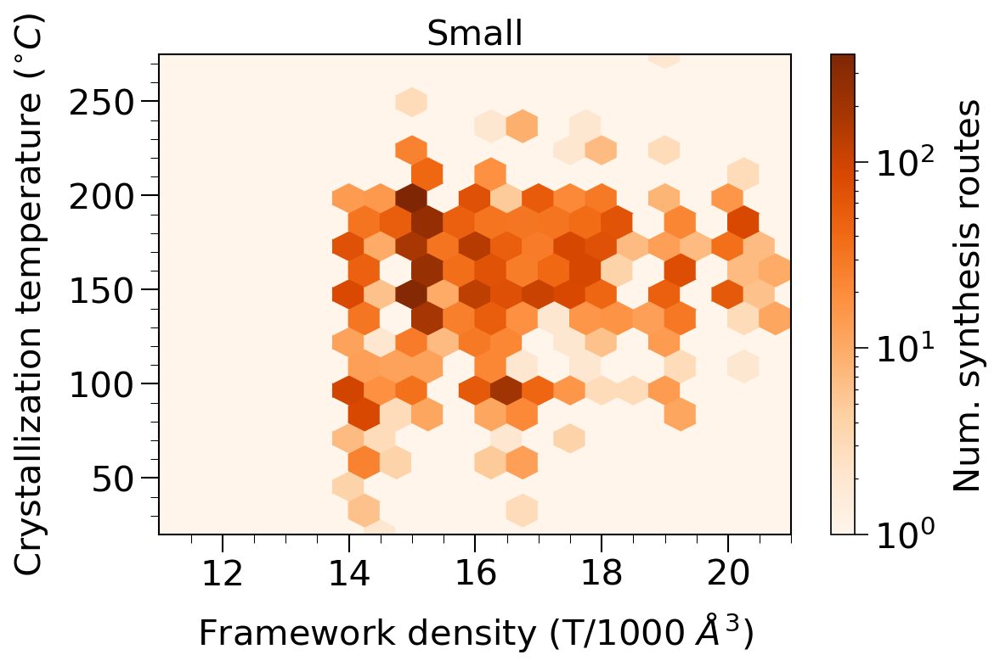

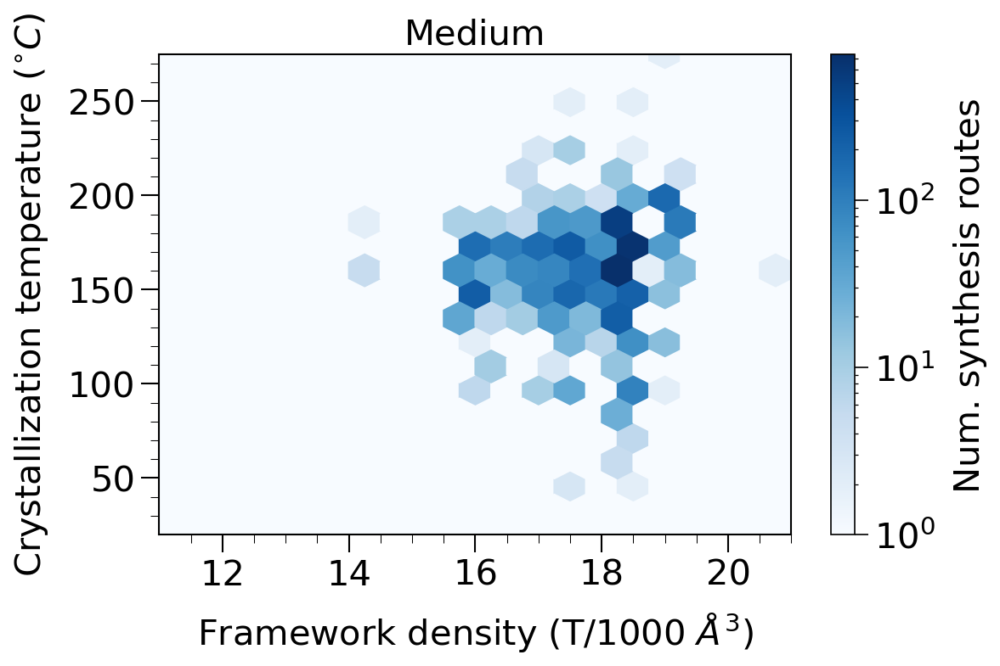

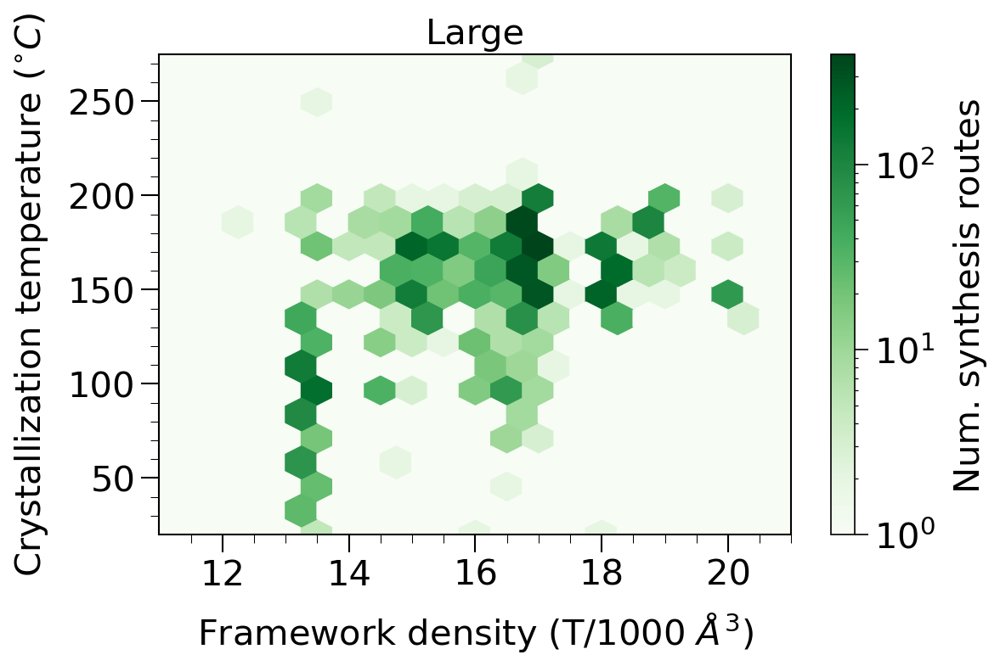

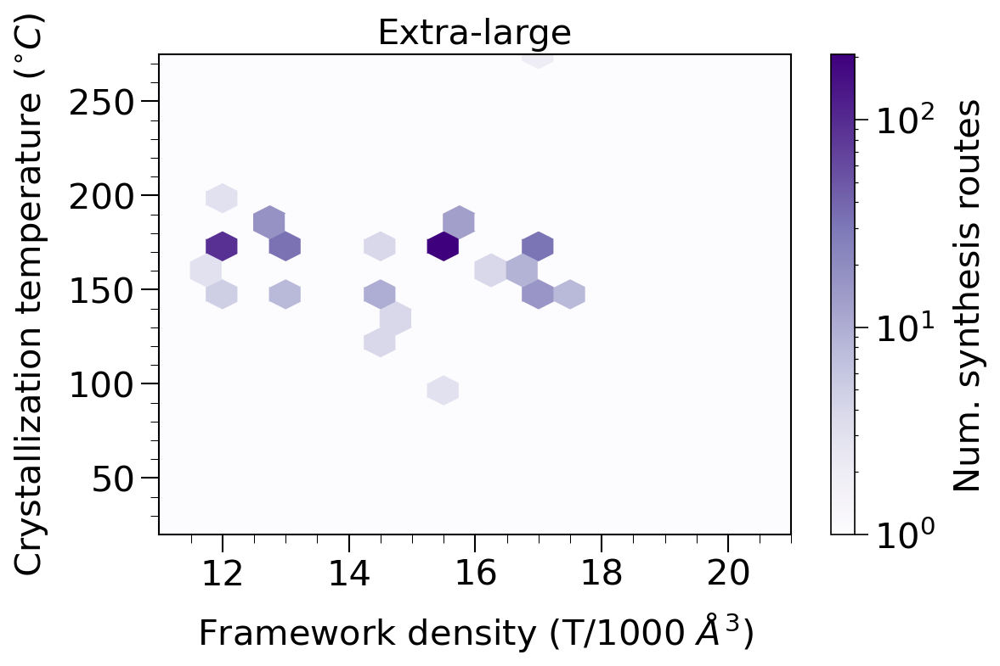

In [40]:
# Cryst_temp vs. FWD for each pore class

pore_classes = ['Small', 'Medium', 'Large', 'Extra-large']
pore_dfs     = [df_s_pore, df_m_pore, df_l_pore, df_xl_pore]
colors       = [s_pore_c, m_pore_c, s_pore_c, m_pore_c]

for pore_class, pore_df in zip(pore_classes, pore_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(pore_df.index)] # Select synthesis of only a certain pore type
    
    if pore_class=='Small':
        cmap = 'Oranges'
    elif pore_class=='Medium':
        cmap = 'Blues'
    elif pore_class=='Large':
        cmap = 'Greens'
    elif pore_class=='Extra-large':
        cmap = 'Purples'
    
    hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
               bins = 'log',
               gridsize = [20,10],
               cmap = cmap,
               extent=[11, 21, 20, 275] # xy limits for hexbin density
                   )

    cb = fig.colorbar(hb, ax=ax)
    cb.ax.tick_params(labelsize=20, size=7.5)
    cb.set_label('Num. synthesis routes', fontsize = 20, labelpad = 10)

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)
    plt.title('{}'.format(pore_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(11,21)
    plt.ylim(20,275)

    plt.show()

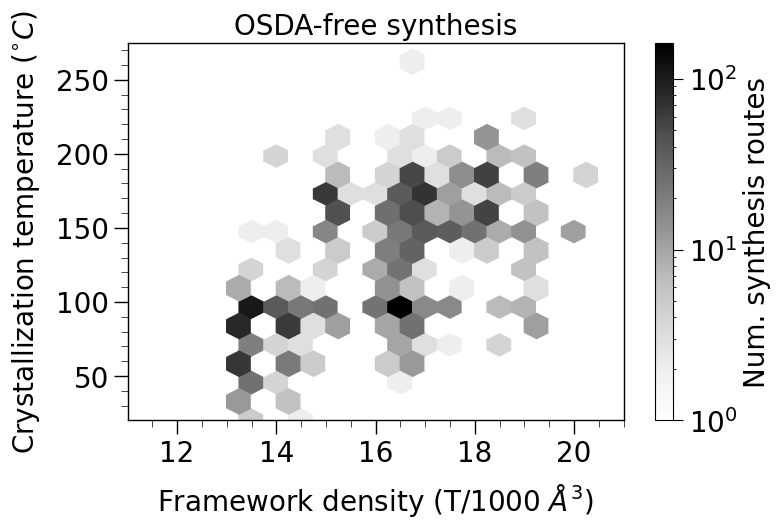

In [41]:
# plot for osda-free synthesis, since some cryst temp are above 230 C, where OSDA will decompose
df_osda_free = df[(df['osda1 smiles'].isna()) & (~df['doi'].isna()) & (~df['Code1'].isna())]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

data = cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_osda_free.index)]
hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
           bins = 'log',
           gridsize = [20,10],
           cmap = 'Greys',
           extent=[11, 21, 20, 275] # xy limits for hexbin density
               )

cb = fig.colorbar(hb, ax=ax)
cb.ax.tick_params(labelsize=20, size=7.5)
cb.set_label('Num. synthesis routes', fontsize = 20)

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)
plt.title('OSDA-free synthesis', fontsize = 20)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(11,21)
plt.ylim(20,275)

plt.show()

In [42]:
# OSDAs of syntheses with crystallization temp > 230
df.loc[cryst_temp_fwd[cryst_temp_fwd['cryst_temp'] >= 230.].index]['osda1 smiles'].value_counts()

CC[N+](CC)(CC)CC                                      14
NCCCCCCN                                               7
C[N+](C)(C)C                                           6
CCC[N+](CCC)(CCC)CCC                                   5
C1CC2CCC1CNC2                                          4
C1CN2CCC1CC2                                           4
CCCC[n+]1ccn(C)c1                                      4
CCCNCCC                                                2
C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCCN2C1     1
CCN(CC)CC                                              1
Cc1cccc(C)[n+]1C                                       1
Name: osda1 smiles, dtype: int64

# Crystallization time w.r.t zeotype

In [43]:
# Cleaning cryst_time column - some integers and str
df['cryst_time'] = df['cryst_time'].apply(lambda x: float(x) if type(x) == int else (0 if x == "\\" else x)) # Int to float and fix '\' entry
df['cryst_time'] = df['cryst_time'].apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers

cryst_time = df['cryst_time']
cryst_time = cryst_time.apply(lambda x: float(x) if type(x) == int else x) # Int to float
cryst_time = cryst_time.apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers
cryst_time = (cryst_time[(~cryst_time.isna())])

cryst_time_SiAl = list(cryst_time[cryst_time.index.isin(SiAl.index)])
cryst_time_SiGe = list(cryst_time[cryst_time.index.isin(SiGe.index)])
cryst_time_SiB = list(cryst_time[cryst_time.index.isin(SiB.index)])
cryst_time_SiT = list(cryst_time[cryst_time.index.isin(SiT.index)])
cryst_time_AlP = list(cryst_time[cryst_time.index.isin(AlP.index)])

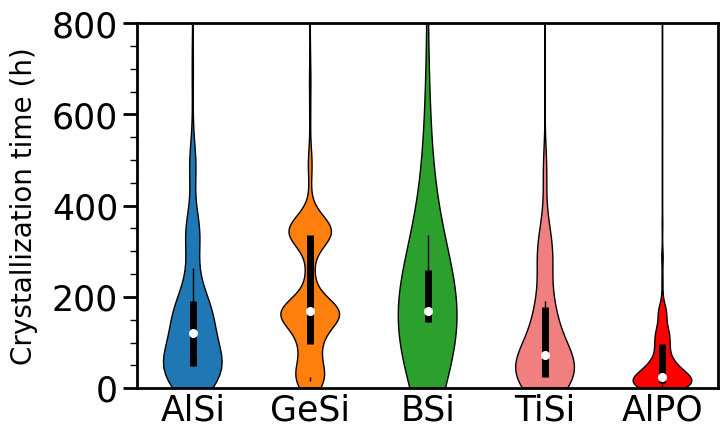

In [44]:
# Data
data     = [cryst_time_SiAl, cryst_time_SiGe, cryst_time_SiB, cryst_time_SiT, cryst_time_AlP]
x_labels = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,800)

plt.ylabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 1000, 200))

plt.show()

# Cryst time w.r.t. pore type

In [45]:
cryst_time_s_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Small'].index)])
cryst_time_m_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Medium'].index)])
cryst_time_l_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Large'].index)])
cryst_time_xl_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Extra-large'].index)])

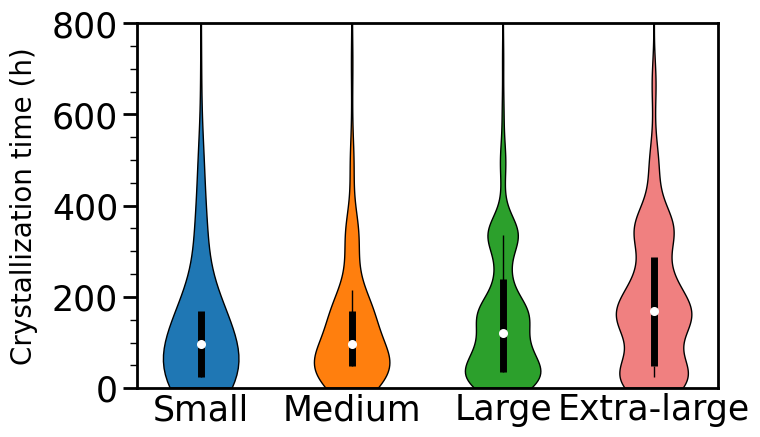

In [46]:
# Data
data     = [cryst_time_s_pore, cryst_time_m_pore, cryst_time_l_pore, cryst_time_xl_pore]
x_labels = ['Small', 'Medium', 'Large', 'Extra-large']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,800)

plt.ylabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 1000, 200))

plt.show()

# Crystallization temp vs. Time

In [47]:
cryst_temp_time = df[['cryst_temp', 'cryst_time']]
cryst_temp_time = cryst_temp_time[
                                    (~cryst_temp_time['cryst_temp'].isna()) \
                                 &  (~cryst_temp_time['cryst_time'].isna())
                                 ]

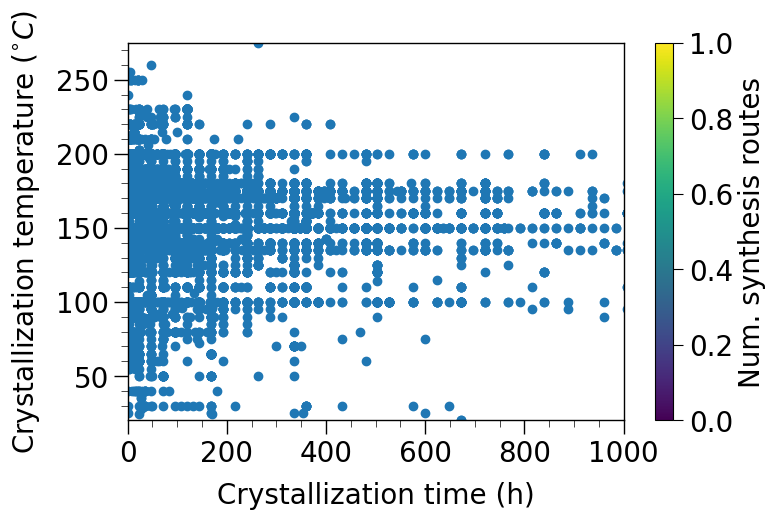

In [48]:
# Aggregated
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

# hb = plt.hexbin(x = cryst_temp_time['cryst_time'] , y= cryst_temp_time['cryst_temp'], 
#            bins = 'log',
#            gridsize = 25,
#            cmap = 'Reds')
hb = plt.scatter(x = cryst_temp_time['cryst_time'] , y= cryst_temp_time['cryst_temp'], 

                )

cb = fig.colorbar(hb, ax=ax)
cb.ax.tick_params(labelsize=20, size=7.5)
cb.set_label('Num. synthesis routes', fontsize = 20)

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(0,1000)
plt.ylim(20,275)

plt.show()

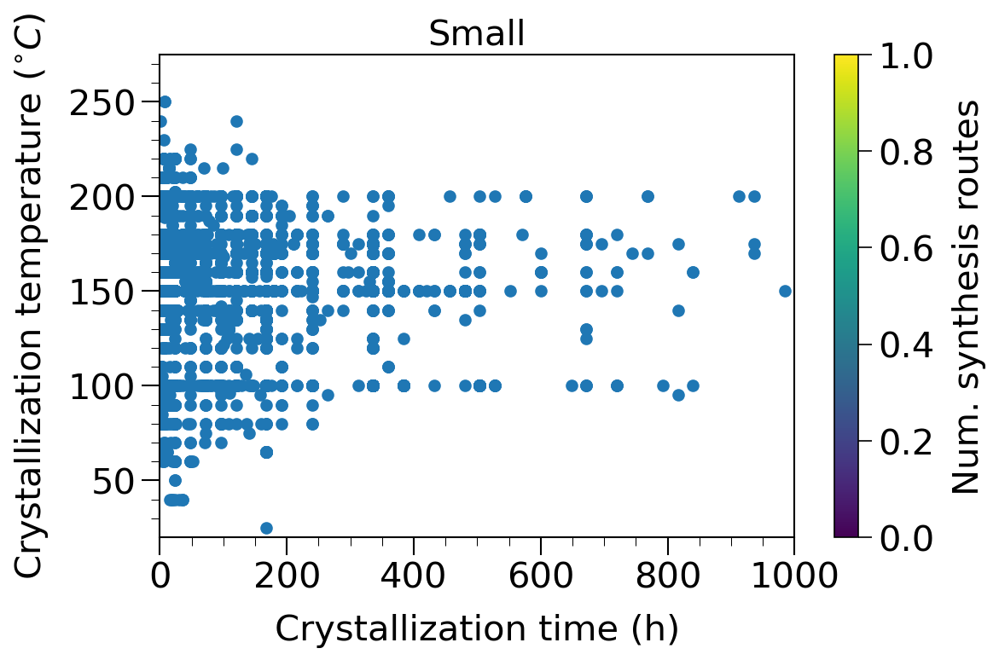

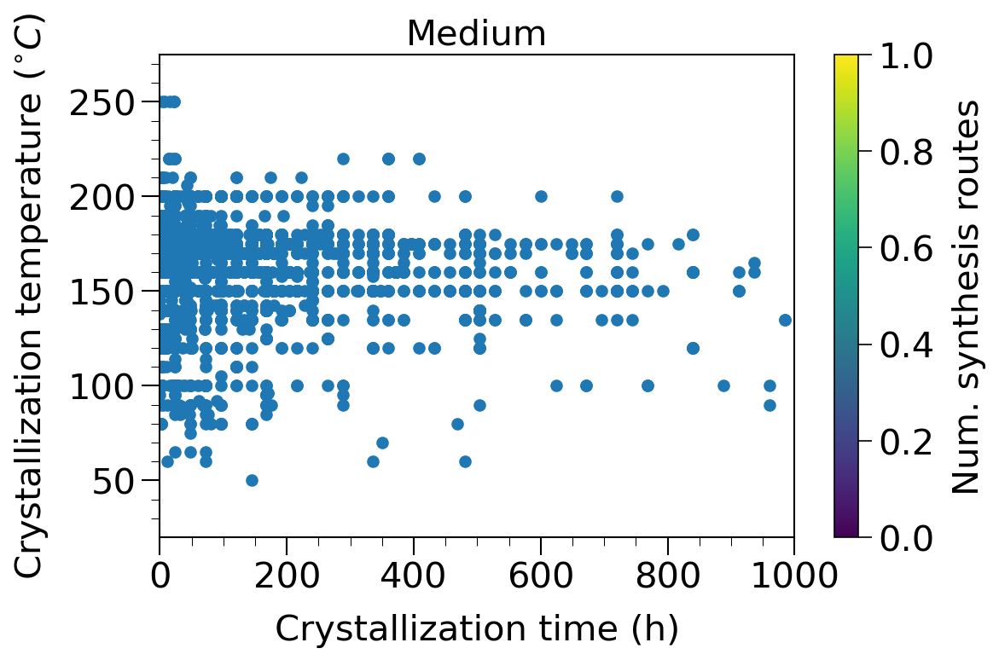

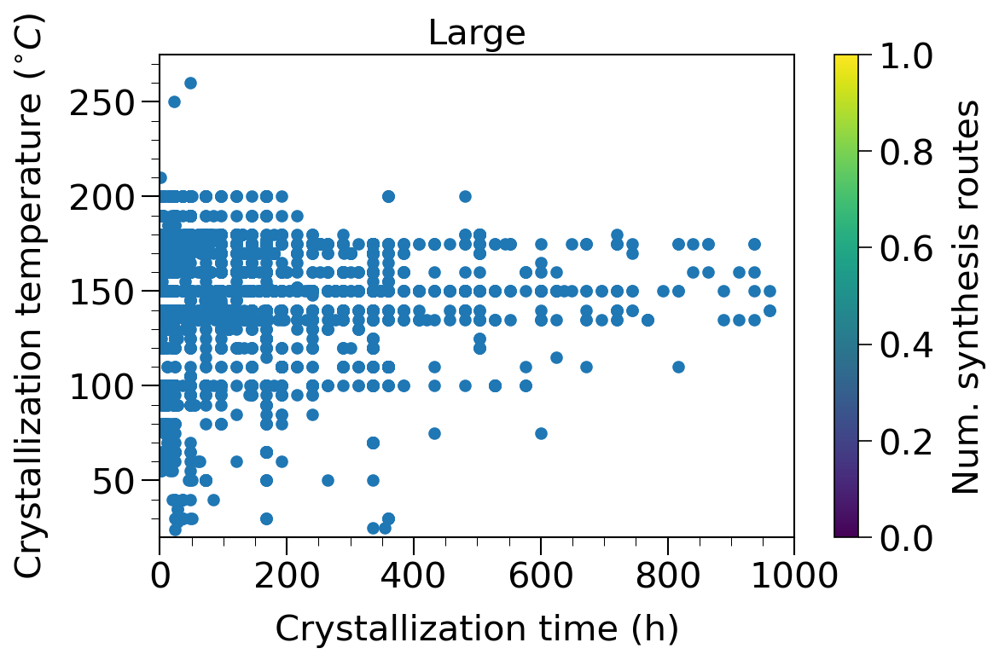

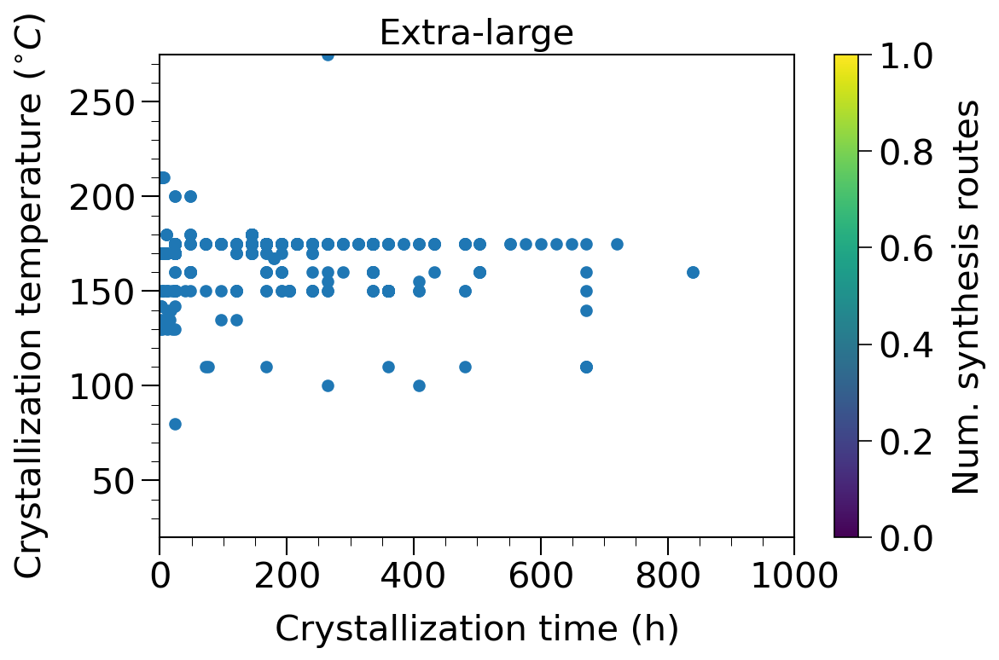

In [49]:
# Cryst_temp vs. cryst_time for each pore class

pore_classes = ['Small', 'Medium', 'Large', 'Extra-large']
pore_dfs     = [df_s_pore, df_m_pore, df_l_pore, df_xl_pore]
colors       = [s_pore_c, m_pore_c, s_pore_c, m_pore_c]

for pore_class, pore_df in zip(pore_classes, pore_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_time.loc[cryst_temp_time.index.isin(pore_df.index)] # Select synthesis of only a certain pore type
    
    if pore_class=='Small':
        cmap = 'Oranges'
    elif pore_class=='Medium':
        cmap = 'Blues'
    elif pore_class=='Large':
        cmap = 'Greens'
    elif pore_class=='Extra-large':
        cmap = 'Purples'
    
#     hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
#                bins = 'log',
#                gridsize = [20,10],
#                cmap = cmap,
#                extent=[11, 21, 20, 275] # xy limits for hexbin density
#                    )
    hb = plt.scatter(x = data['cryst_time'] , y= data['cryst_temp'], 

                )

    cb = fig.colorbar(hb, ax=ax)
    cb.ax.tick_params(labelsize=20, size=7.5)
    cb.set_label('Num. synthesis routes', fontsize = 20, labelpad = 10)

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)
    plt.title('{}'.format(pore_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(0,1000)
    plt.ylim(20,275)

    plt.show()

# Crystallization temp vs. time for different zeotypes

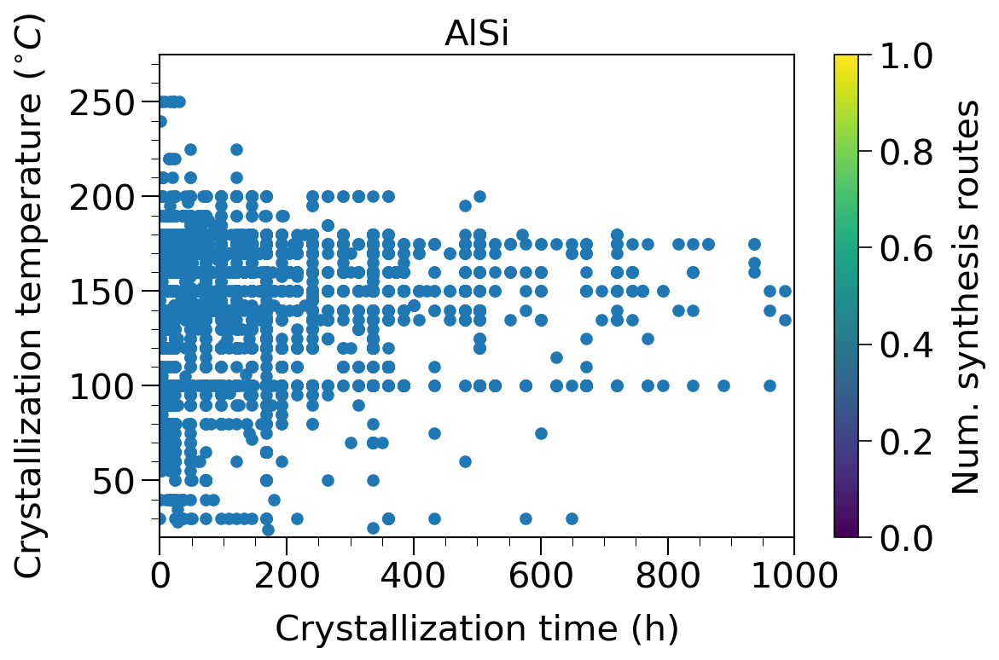

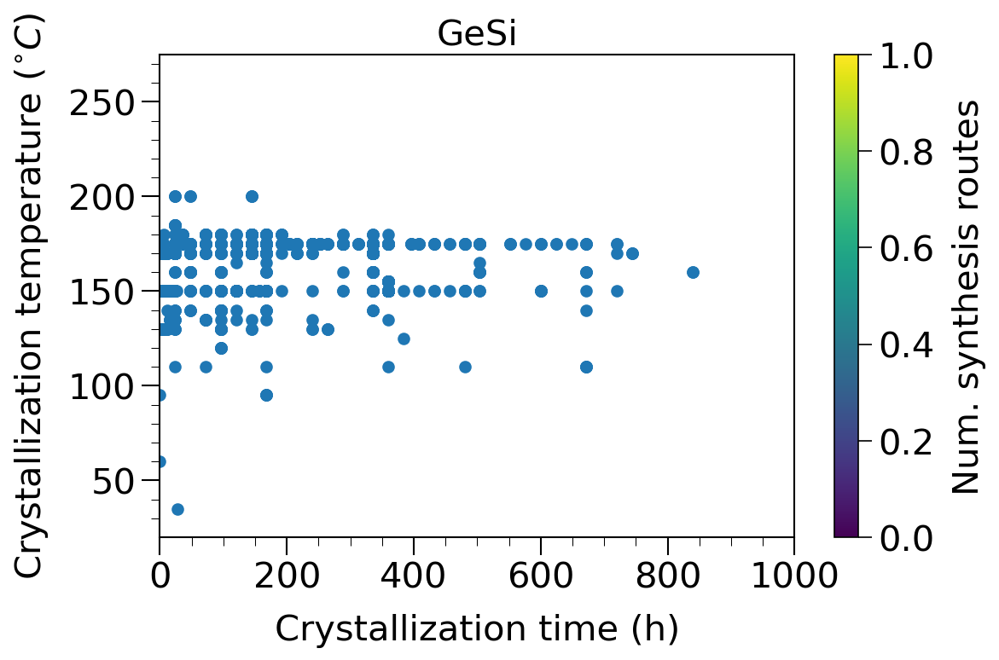

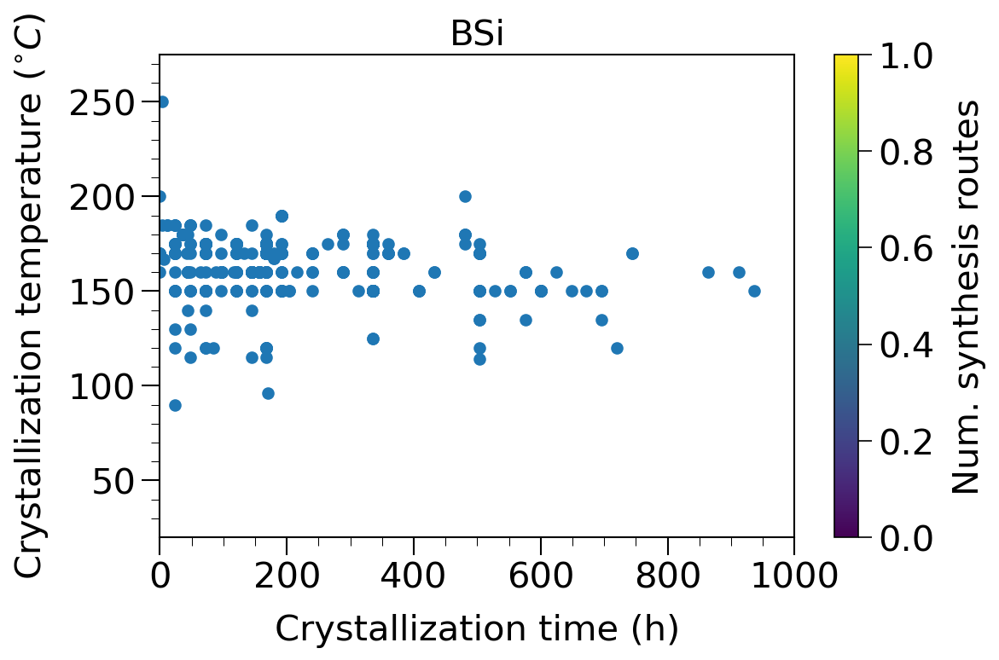

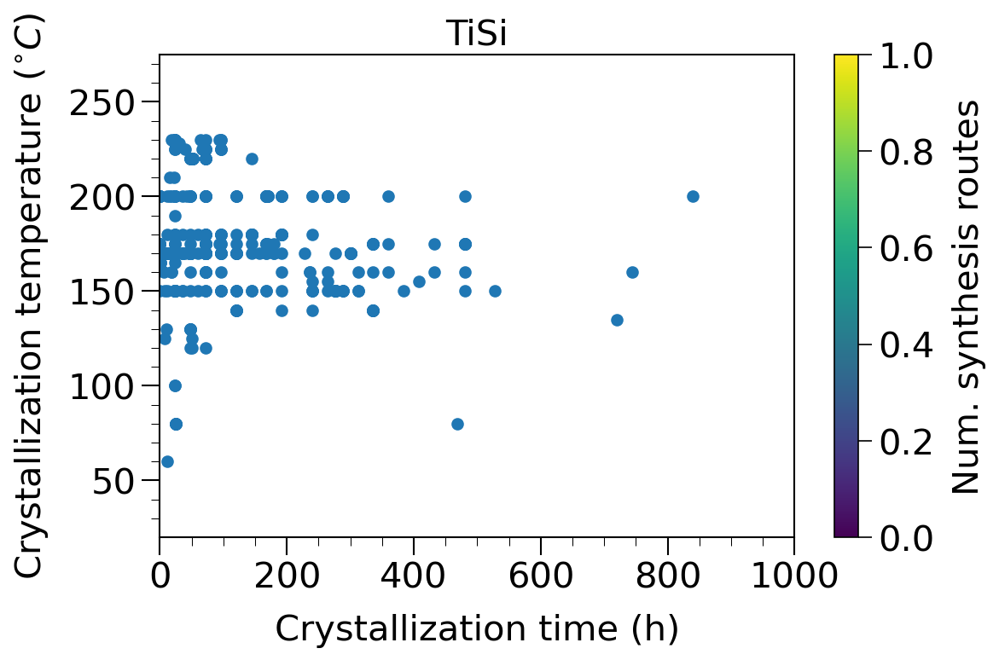

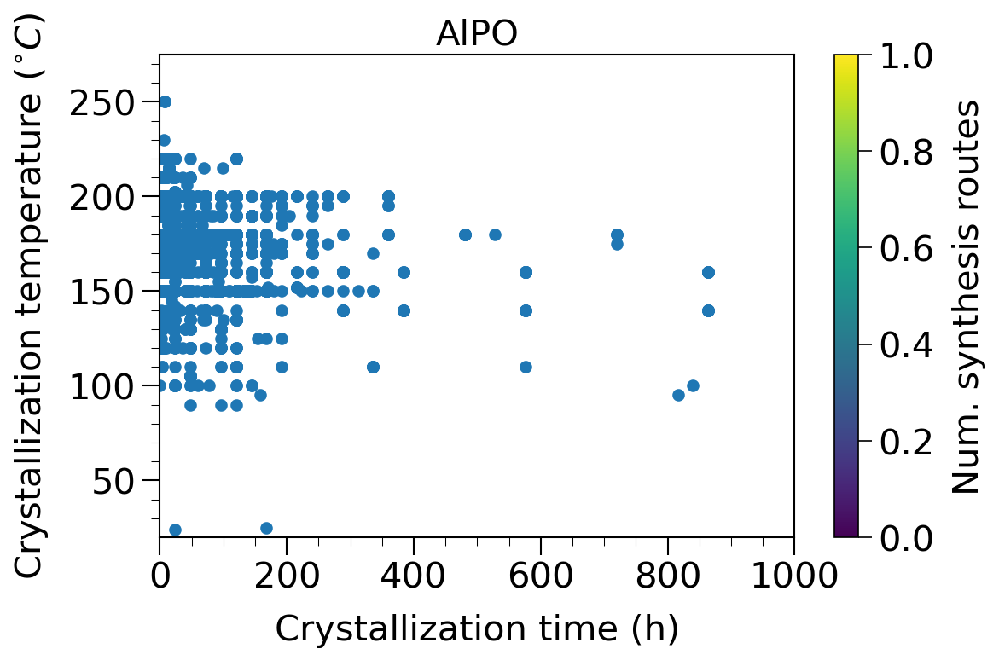

In [50]:
# Cryst_temp vs. cryst_time for each pore class

zeotype_classes = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
zeotype_dfs  = [SiAl, SiGe, SiB, SiT, AlP]

for zeotype_class, zeotype_df in zip(zeotype_classes, zeotype_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_time.loc[cryst_temp_time.index.isin(zeotype_df.index)] # Select synthesis of only a certain pore type
    
    if zeotype_class=='AlSi':
        cmap = 'Blues'
    elif zeotype_class=='GeSi':
        cmap = 'Oranges'
    elif zeotype_class=='BSi':
        cmap = 'Greens'
    elif zeotype_class=='TiSi':
        cmap = 'Purples'
    elif zeotype_class=='AlPO':
        cmap = 'Reds'
    
#     hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
#                bins = 'log',
#                gridsize = [20,10],
#                cmap = cmap,
#                extent=[11, 21, 20, 275] # xy limits for hexbin density
#                    )
    hb = plt.scatter(x = data['cryst_time'] , y= data['cryst_temp'], 

                )

    cb = fig.colorbar(hb, ax=ax)
    cb.ax.tick_params(labelsize=20, size=7.5)
    cb.set_label('Num. synthesis routes', fontsize = 20, labelpad = 10)

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)
    plt.title('{}'.format(zeotype_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(0,1000)
    plt.ylim(20,275)

    plt.show()

# t-SNE plot of synthesis space

In [51]:
tsne_cols = [
 'Si', 'Al','P','Na','K','Li','Sr','Rb','Cs','Ba','Ca','F','Ge','Ti','In','B',
#     'Mg','Ga','Ni','Mn','Fe','Co','Cr','Zn','Nb','Be','W','Ce','Cu','Sn','Gd','La','Y','Dy','Sm','Ag','Cd','Zr','V',
    'H2O',
 'sda1',
# 'Ta','Ru','Hf','Yb','Tl','As',
'OH',
'cryst_time','cryst_temp',
 'osda_asphericity_mean_0','osda_axes_mean_0','osda_axes_mean_1','osda_bertz_ct_mean_0',
 'osda_eccentricity_mean_0','osda_free_sasa_mean_0',
 'osda_gyration_radius_mean_0','osda_inertial_shape_factor_mean_0', 'osda_npr1_mean_0', 'osda_npr2_mean_0',
 'osda_num_bonds_mean_0', 'osda_num_rot_bonds_mean_0', 'osda_pmi1_mean_0','osda_pmi2_mean_0','osda_pmi3_mean_0','osda_spherocity_index_mean_0','osda_volume_mean_0','osda_mol_weight','osda_formal_charge',
]

df_without_na = df[~df['doi'].isna()]
df_without_na = df_without_na[~df_without_na['Code1'].isna()] # remove failed synthesis

# df_without_na = df_without_na[df_without_na.index.isin(SiAl.index)] # restrict to specific zeotype

df_tsne = df_without_na[tsne_cols]

# Check number of NaN for each column - OH, cryst_time, cryst_temp are the problematic ones
for col in df_tsne.columns:
    print('Col: ', col)
    print(df_tsne[col].isna().sum())
    print()

Col:  Si
0

Col:  Al
0

Col:  P
0

Col:  Na
0

Col:  K
0

Col:  Li
0

Col:  Sr
0

Col:  Rb
0

Col:  Cs
0

Col:  Ba
0

Col:  Ca
0

Col:  F
0

Col:  Ge
0

Col:  Ti
0

Col:  In
0

Col:  B
0

Col:  H2O
0

Col:  sda1
0

Col:  OH
0

Col:  cryst_time
1270

Col:  cryst_temp
509

Col:  osda_asphericity_mean_0
0

Col:  osda_axes_mean_0
0

Col:  osda_axes_mean_1
0

Col:  osda_bertz_ct_mean_0
0

Col:  osda_eccentricity_mean_0
0

Col:  osda_free_sasa_mean_0
0

Col:  osda_gyration_radius_mean_0
0

Col:  osda_inertial_shape_factor_mean_0
0

Col:  osda_npr1_mean_0
0

Col:  osda_npr2_mean_0
0

Col:  osda_num_bonds_mean_0
0

Col:  osda_num_rot_bonds_mean_0
0

Col:  osda_pmi1_mean_0
0

Col:  osda_pmi2_mean_0
0

Col:  osda_pmi3_mean_0
0

Col:  osda_spherocity_index_mean_0
0

Col:  osda_volume_mean_0
0

Col:  osda_mol_weight
0

Col:  osda_formal_charge
0



In [52]:
# Imputation for NaN in cryst_time and cryst_temp
columns = list(df_tsne.columns) # Save columns
imp = IterativeImputer(min_value = 0., sample_posterior = True, skip_complete = True, random_state=0) # Sample posterior to get a distribution, skip_complete to speed up, min value is 0. since time and temp are +ve
imp.fit(df_tsne)
df_tsne = pd.DataFrame(imp.transform(df_tsne), columns = df_tsne.columns)

In [53]:
# tsne plot for most frequent zeolites
scaler = StandardScaler()
scaler.fit(np.array(df_tsne))
df_tsne_scaled = scaler.transform(np.array(df_tsne))

# t-SNE
embed = TSNE(n_components=2, perplexity=50., init='pca', random_state = 0).fit_transform(df_tsne_scaled)

# # UMAP
# embed = umap.UMAP(
#                 n_neighbors = 200,
#                  random_state = 0,
#                  ).fit_transform(np.array(df_tsne_scaled))

df_without_na['tsne_0'], df_without_na['tsne_1'] = embed[:,0], embed[:,1]

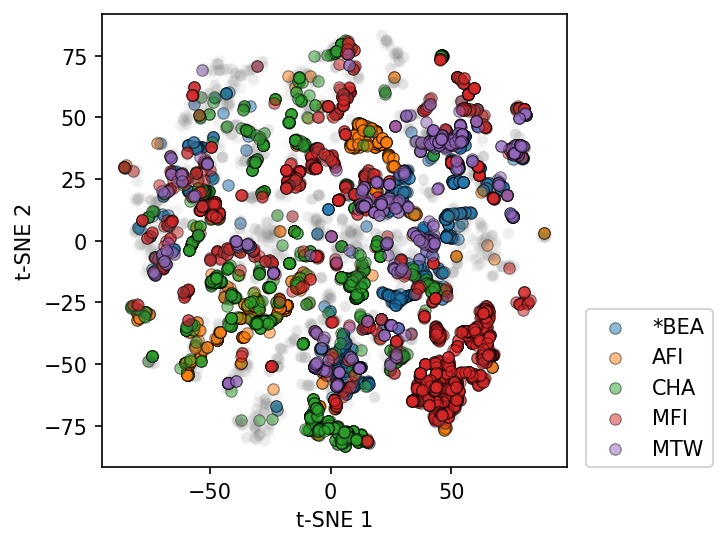

In [54]:
n_zeos = 5 # number of zeos to color

plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('Code1'):
    if zeo in zeos_value_counts[:n_zeos]: # top n zeolites
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 30, alpha = 0.5, label = zeo,
                            edgecolor = 'black', linewidth = 0.5
                   )
    else:
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 30, alpha = 0.01, color = 'grey',
                            edgecolor = 'grey', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

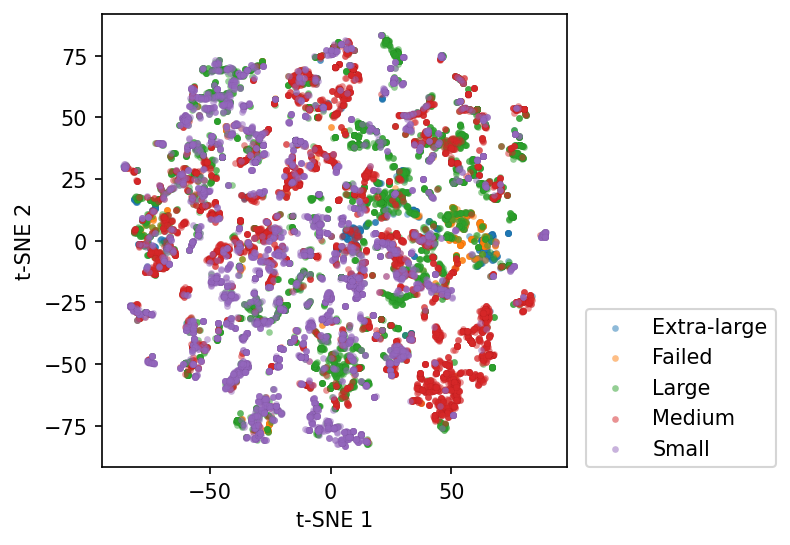

In [55]:
# pore type

plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('pore_type'):
    plt.scatter(data['tsne_0'], data['tsne_1'], s = 10, alpha = 0.5, label = zeo,
                            edgecolor = 'black', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

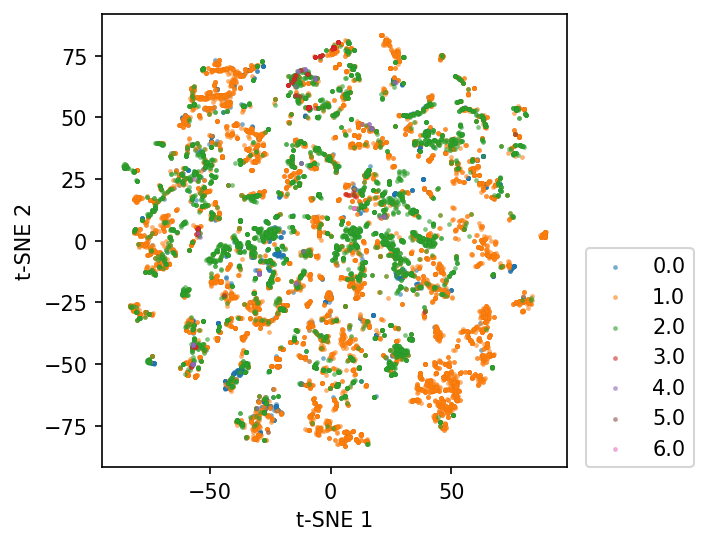

In [56]:
# num channels

plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('chan_num_channels'):
    plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 0.6, label = zeo,
                            edgecolor = 'black', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

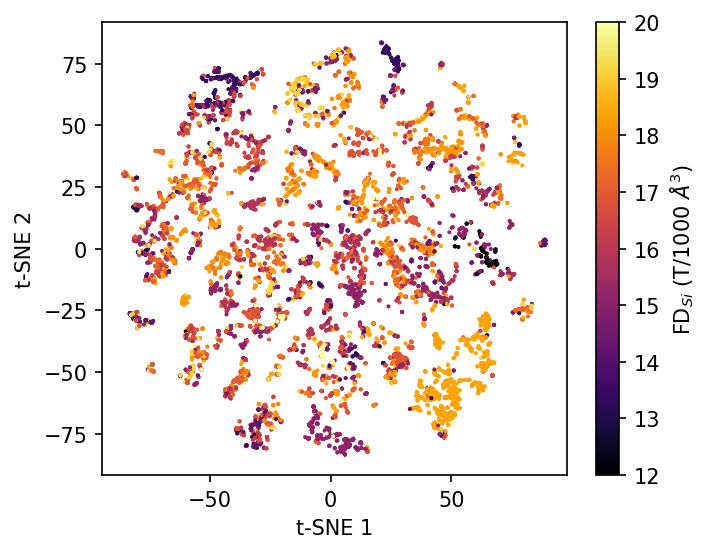

In [57]:
# Framework density
plt.figure(figsize = (5,4), dpi = 150)

plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['framework_density'], cmap = 'inferno'
#                             edgecolor = 'black', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.colorbar(label = 'FD$_{Si}$ (T/1000 $\AA^{3}$)')
plt.clim(12,20)
plt.show()

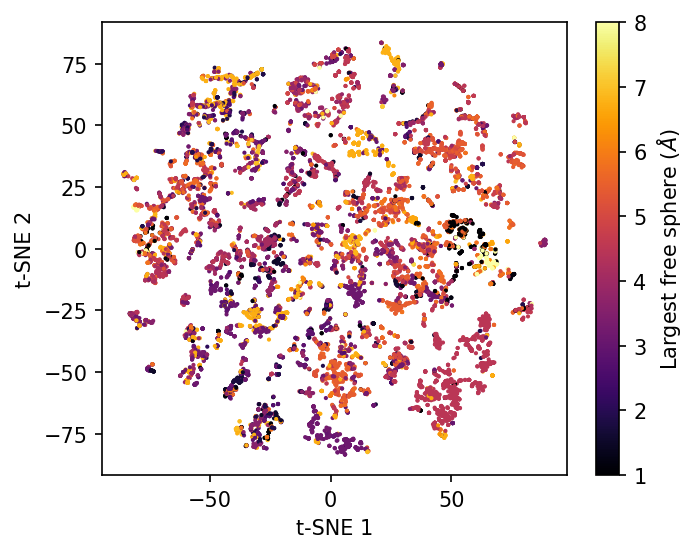

In [58]:
# largest_free_sphere
plt.figure(figsize = (5,4), dpi = 150)

plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['largest_free_sphere'], cmap = 'inferno'
#                             edgecolor = 'black', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
cb = plt.colorbar(label = "Largest free sphere ($\AA$)")
plt.clim(1,8) 
plt.show()

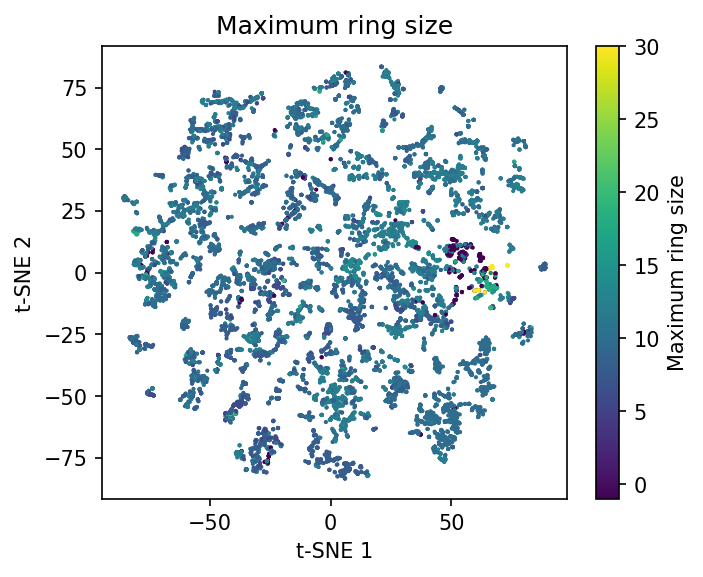

In [59]:
# Max ring size
plt.figure(figsize = (5,4), dpi = 150)

plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['ring_size_0'], cmap = 'viridis'
#                             edgecolor = 'black', linewidth = 0.01
                   )
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
cb = plt.colorbar(label = "Maximum ring size")
plt.title('Maximum ring size')
# plt.clim(5,30) 
plt.show()

In [60]:
df['chan_0_dim'].value_counts()

3.0    8367
1.0    3903
2.0    2123
0.0    1061
Name: chan_0_dim, dtype: int64

In [61]:
# continuous
zeo_cols_cont = [
 'num_atoms',
 'a',
 'b',
 'c',
 'alpha',
 'beta',
 'gamma',
 'volume',
 'td',
 'rdls',
 'td_10',
 'ring_size_0',
 'ring_size_1',
 'ring_size_2',
 'ring_size_3',
 'ring_size_4',
 'ring_size_5',
 'ring_size_6',
 'framework_density',
 'largest_free_sphere',
 'accessible_volume_izc',
 'largest_free_sphere_a',
 'largest_free_sphere_b',
 'largest_free_sphere_c',
 'largest_free_sphere_izc',
 'largest_included_sphere',
 'largest_free_sphere_a_izc',
 'largest_free_sphere_b_izc',
 'largest_free_sphere_c_izc',
 'largest_included_sphere_a',
 'largest_included_sphere_b',
 'largest_included_sphere_c',
 'largest_included_sphere_fsp',
 'largest_included_sphere_izc',
 'num_atoms_per_vol',
'unitcell_vol',
 'density',
 'asa_a2',
 'asa_m2_cm3',
 'asa_m2_g',
 'nasa_a2',
 'nasa_m2_cm3',
 'nasa_m2_g',
 'chan_0_sa_a2',
 'chan_1_sa_a2',
 'chan_2_sa_a2',
 'chan_3_sa_a2',
 'chan_4_sa_a2',
 'chan_5_sa_a2',
 'chan_0_dim',
'sa_num_pockets',
 'av_a3',
 'av_frac',
 'av_cm3_g',
 'nav_a3',
 'nav_frac',
 'nav_cm3_g',
 'chan_0_vol_a3',
 'chan_1_vol_a3',
 'chan_2_vol_a3',
 'chan_3_vol_a3',
 'chan_4_vol_a3',
 'chan_5_vol_a3',
 'avol_num_pockets',
 'poav_a3',
 'poav_frac',
 'poav_cm3_g',
 'ponav_a3',
 'ponav_frac',
 'ponav_cm3_g',
 'probe_rad',
 'N_points',
 'probe_ctr_A_fract',
 'probe_ctr_NA_fract',
 'A_fract',
 'NA_fract',
 'narrow_fract',
 'ovlpvfract',
 'deriv_mean',
 'deriv_variance',
 'deriv_skewness',
 'deriv_kurtosis',
 'cum_mean',
 'cum_variance',
 'cum_skewness',
 'cum_kurtosis',
 'num_si',
]

# discrete
zeo_cols_disc = [
#      'cbu',
#  'iza',
 'chan_num_channels',
 'sa_num_channels',
 'avol_num_channels',
 'isdisordered',
 'isinterrupted',
]

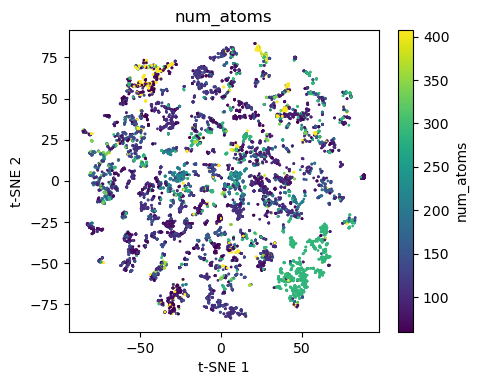

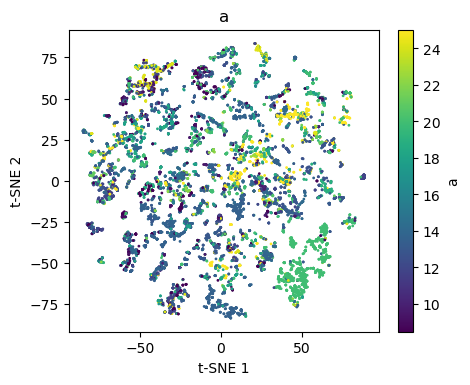

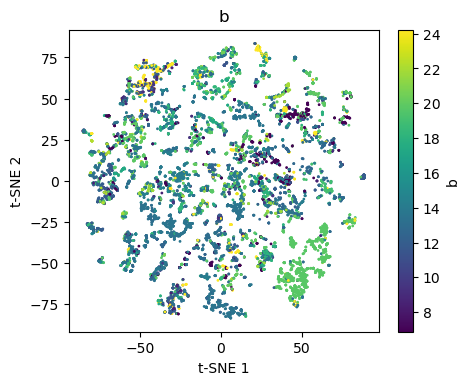

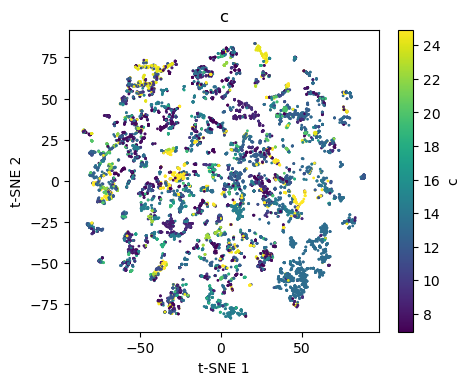

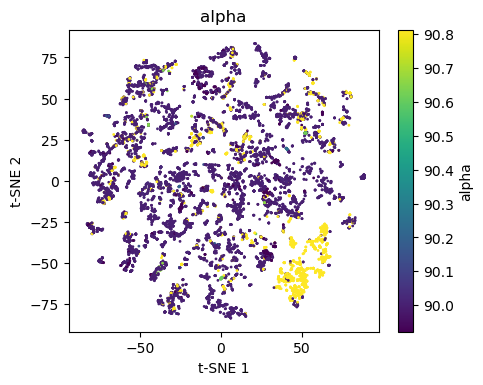

...

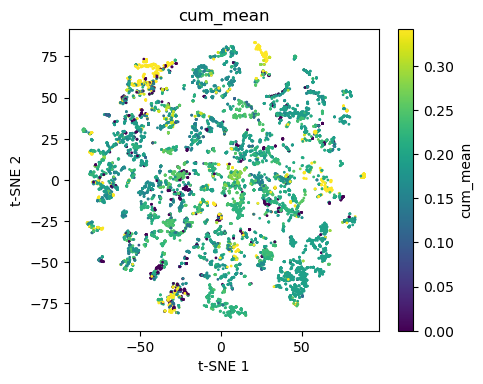

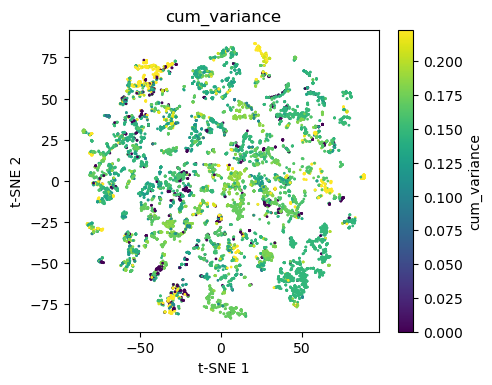

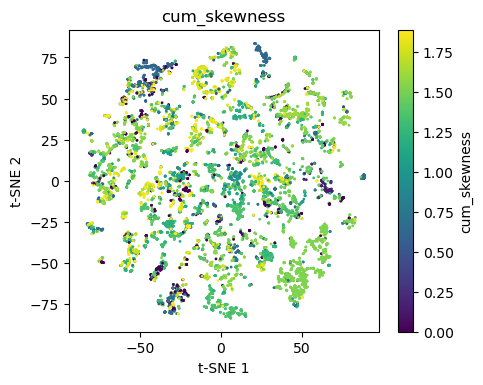

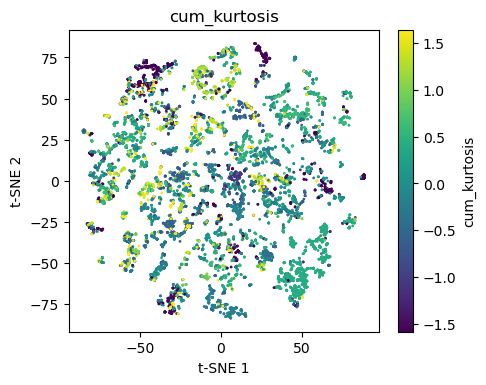

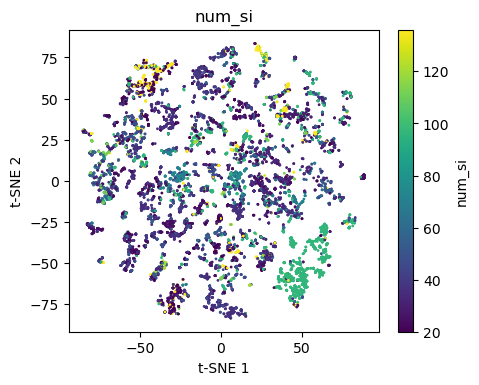

In [62]:
for col in zeo_cols_cont:
    plt.figure(figsize = (5,4), dpi = 100)
    
    plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
                c = df_without_na[col], cmap = 'viridis', 
                       )
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.title(col)
    cb = plt.colorbar(label = col)
    if df_without_na[col].isna().sum() != len(df_without_na[col].isna()): # if not all values are NaN,
        plt.clim(np.percentile(df_without_na[col].dropna(), [5,95]))
    plt.show()

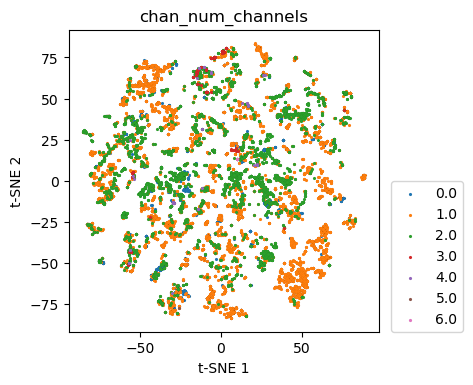

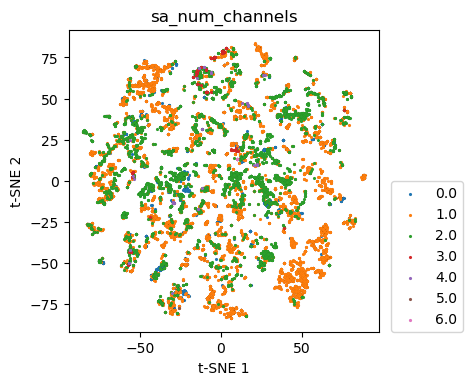

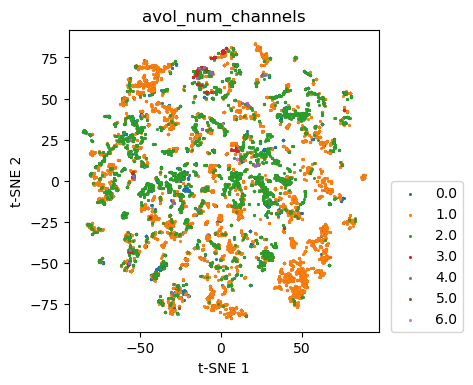

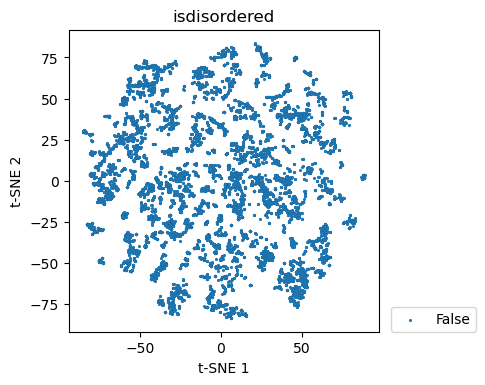

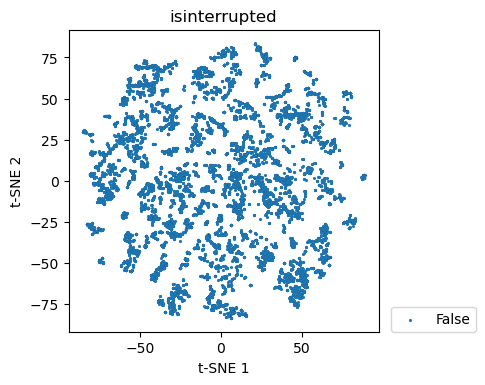

In [63]:
for col in zeo_cols_disc:
    plt.figure(figsize = (4,4), dpi = 100)
    for label, data in df_without_na.groupby(col):
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 1, label = label,
                                edgecolor = 'black', linewidth = 0.01
                       )
    plt.title(col)
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.legend(loc=(1.04, 0))
    plt.show()

In [64]:
# Find unique set of cbus present in dataset
cbus_unique = []
for cbu_combination in df_without_na['cbu'].value_counts().index:
    for cbu in cbu_combination:
        if cbu not in cbus_unique:
            cbus_unique.append(cbu)

# Get one-hot encoding of cbus
cbu_oh = np.zeros([len(df_without_na), len(cbus_unique)]) # initialize one-hot encoding with zeros
cbu_oh = pd.DataFrame(cbu_oh, columns = cbus_unique, index = df_without_na.index)

for idx in df_without_na.index:
    cbus = df_without_na.loc[idx]['cbu']
    print(cbus)
    if (cbus == None) or (len(cbus) == 0): # either None or empty list
        pass
    elif (len(cbus) > 0) and (type(cbus) == list): # if non-empty list of cbus exists 
        print('list exists')
        for cbu in cbus: # modify one-hot encoding of cbus
            cbu_oh.loc[idx, cbu] = 1.0
    print()

# append one-hot encoding of CBUs to df_without_na
df_without_na = pd.concat([df_without_na, cbu_oh], axis = 1)

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afs', 'bph']
list exists

['d4r', 'rth', 'lta']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['cas', 'bik']
list exists

[]

None

None

None

None

None

None

None

None

None

None

None

['non']
list exists

None

None

None

['non']
list exists

None

None

None

None

['mor', 'd4r', 'mtw']
list exists

['afi', 'cas', 'mtw', 'dzc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'bea', 'mtw']
list exists

['bog']
list exists

['bog']
list exists

['rth']
list exists

['rth']
list exists

['rth']
list exists

['d4r', 'mel', 'd3r']
list exists


['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['sti', 'bre']
list exists

['sti', 'bre']
list exists

['sti', 'bre']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['d6r', 'pau', 'lta']
list exists

['d8r', 'lta']
list exists

['d8r', 'lta']
list exists

['d8r', 'lta']
list exists

['mor', 'bik']
list exists

['d6r', 'lev']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r']
list exists

['rth']
list exists

['rth']
list exists

['d4r', 'sod', 'lta']
list exists

['mtn']
list exists

['mtn']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['sod']
list exists

['can', 'los']
list exists

['can', 'los']
list exists

['can', 'los']
list exists

['can', 'los']
list exists


['mor', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'sod']
list exists

['mor', 'mfi', 'mel']
list exists

None

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'sod']
list exists

['afi', 'bog', 'nsc']
list exists

[]

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pc

['d4r', 'bre', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['mor', 'd4r', 'mtw']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['mor', 'd4r', 'mtw']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['mor', 'd4r', 'mtw']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['cas', 'non']
list exists

['mor', 'mtt', 'stf', 'lau', 'cas']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

None

['d6r', 'cha']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r']
list exists

['d6r']
list exists

['afi', 'bog', 'dnc']
list exists

['afi', 'bog', 'nsc']
list exists

['sti', 'd8r', 'atn']
list exists

['sti', 'd8r', 'atn']
list exists

None

['d4r', 'sod', 'lta']
list exists

['d6r', 'sod']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['sod']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['rte', 'rut']
list exists

['cas', 'bik']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['rth']
list exists

['d6r']
list exists

None

None

['

['afs', 'bph']
list exists

['d6r', 'gme']
list exists

['d6r', 'lev']
list exists

['d6r', 'gme']
list exists

['d6r', 'lev']
list exists

['d6r', 'lev']
list exists

['d6r', 'lev']
list exists

['gme', 'dsc']
list exists

None

None

None

None

None

None

None

None

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['ddr', 'mtn']
list exists

['ddr', 'mtn']
list exists

['ddr', 'mtn']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['gis',

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mtt', 'cas', 'ton', 'dzc']
list exists

['afi', 'mel', 'dcc']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['ddr', 'mtn']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists


['nsc']
list exists

['nsc']
list exists

['nsc']
list exists

['nsc']
list exists

['nsc']
list exists

['nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'd4r', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik'

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['d6r', 'gme']
list exists

['d6r', 'gme']
list exists

['d6r', 'gme']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

None

None

None

None

None

None

None

['d6r', 'can', 'lev', 'ave']
list exists

['d6r', 'can', 'lev', 'ave']
list exists

['d6r', 'can', 'lev', 'ave']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'can', 'lev', 'ave']
list exists

['d6r', 'can', 'lev', 'ave']
list exists



['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list 

None

None

None

None

None

None

None

None

None

None

None

['bea', 'lau']
list exists

['nat']
list exists

['nat']
list exists

['nat']
list exists

['nat']
list exists

['nat']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['d4r', 'ast']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

['nsc']
list exists

['d6r', 'cha']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afs', 'bph', 'afy']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['abw', 'dzc']
list exists

['abw', 'dzc']
list exists

['abw', 'dzc']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

[]

['d4r', 'ast']
list exists

None

[]

[]

['d6r', 'cha']
list exists

[]

[]

['d6r', 'cha']
list exists

[]

['d6r', 'cha']
list exists

[]

[]

[]

[]

['mor', 'mfi', 'mel']
list exists

['gis', 'dcc']


['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

None

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

None

None

['d4r', 'ast']
list exists

['non']
list exists

['non']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['non']
list exists

['d4r', 'ast']
list exists

['ddr', 'mtn']
list exists

['non']
list exists

['

['mor', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'mel']
list exists

['bea', 'cas']
list exists

[]

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'fer', 'pcr']
list exists

None

['afi', 'bog', 'nsc']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['ats', 'dzc']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists


['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mtn']
list exists

['mtn']
list exists

['mtn']
list exists

['mtn']
list exists

['mtn']
list exists

['mtn']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list 

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['d6r', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor'

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d4r']
list exists

['rth']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'gme', 'aft']
list exists

['d6r', 'gme', 'aft']
list exists

['mor', 'd4r', 'mtw']
list exists

None

None

None

None

None

['sod']
list exists

['afs', 'bph']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['mei']
list exists

['afs', 'bph']
list exists

['afs', 'bph']
list exists

['afs', 'bph']
list exists

['afs', 'bph']
list exists

['afs', 'bph']
list exists

['afi', 'bog', 'nsc']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['mtn', 'doh']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'sod', 'lt

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'mel']
list exists

None

['d4r', 'ast']
list exists

['mor', 'fer']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists



None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

[]

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'ns

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

None

None

None

None

None

None

None

None

None

None

None

None

None

None

['d6r', 'mel']
list exists

None

None

['d6r', 'mel']
list exists

None

None

['d6r', 'mel']
list exists

None

None

None

None

None

None

['d6r', 'mel']
list exists

None

None

['d6r', 'mel']
list exists

None

None

['d6r', 'mel']
list exists

None

None

['d6r', 'mel']
list exists

None

['d6r', 'mel']
list exists

No

None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

None

None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor']
list exists

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

None

None

['mor']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

None

['jbw', 'cas', 'bik', 'mtw']
list exists

None

['d6r', 'gme', 'aft']
list exists

['jbw', 'mtt', 'bik', 'ton']
list e

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['cas', 'mtw']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

None

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['mor', 'd4r', 'cas', 'fer',

['jbw', 'mtt', 'bik', 'ton']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['sod']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'mel']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'mel']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'cha']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['d6r']
list exists

['d6r']
list exists

['d6r'

['jbw', 'cas', 'bik', 'mtw']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['non']
list exists

['non']
list exists

None

['non']
list exists

['non']
list exists

['non']
list exists

['non']
list exists

None

None

['non']
list exists

['non']
list exists

None

['non']
list exists

['non']
list exists

['non']
list exists

['non']
list exists

None

None

None

None

None

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

None

None

None

['cas']
list exists

['cas']
list exists

['cas']
list exists

['cas']
list exists

['cas']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['bea', 'lau']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor'

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['d6r', 'sod']
list exists

['phi', 'dcc']
list exists

['d8r', 'pau', 'dcc']
list exists

['mor', 'mtt', 'stf', 'lau', 'cas']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor'

['d6r']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'mfi', 'mel']
list exists

['d6r', 'sod']
list exists

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'sod']
list exists

['d6r', 

None

None

['d6r', 'cha']
list exists

[]

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'sod']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'can', 'ltl', 'dsc']
list exists

['d4r', 'sod', 'lta']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

None

['d4r', 'sod', 'lta']
list exists

None

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw',

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'cha']
list exists

['d8r', 'pau', 'dcc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'sod']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

[]

None

None

['mor', 'bea', 'mtw']
list exists

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'ns

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

['mor', 'mfi', 'mel']
list exists

['mor', 'mfi', 'mel']
list exists

['mor', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor', 'cas',

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

None

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['d6r', 'cha']
list exists

['d4r', 'sod', 'lta']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d4r', 'sod', 'lta']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['afi', 'bog', 'dnc']
list exists

['d4r', 'ast']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', '

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['d6r', 'can']
list exists

['d6r', 'cha']
list exists

None

['d6r', 'cha']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor']
list exists

['mor']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']

['gme', 'dsc']
list exists

['d6r', 'sod']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

None

None

None

None

None

None

None

None

['d6r', 'sod']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists



['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

None

['d6r', 'can', 'ltl', 'dsc']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'd4r', 'cas', 'fer',

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

[]

[]

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

None

['afi', 'bog', 'nsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi'

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r'

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'mtt', 'fer']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

None

None

None

None

None

None

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

None

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['sod']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'm

['mor']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists


['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mtt', 'cas', 'ton', 'dzc']
list exists

['mtt', 'cas', 'ton', 'dzc']
list exists

['mtt', 'cas', 'ton', 'dzc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list 

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

['d4r']
list exists

None

None

None

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor']
list exists

['mor']
list exists


['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d4r', 'sod', 'lta']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['bea', 'lau']
list exists

['bea', 'cas']
list exists

['stf', 'cas']
list exists

['stf', 'cas']
list exists

['mor', 'd4r', 'mtw']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['mor', 'cas'

['mor', 'fer', 'pcr']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor']
list exists

['mor']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

None

['jbw', 'cas', 'bik', 'mtw']
list exists

[]

[]

['sti']
list exists

['sti']
list exists

[]

[]

[]

[]

['sti']
list exists

['sti']
list exists

[]

['sti']
list exists

[]

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exists

['d4r', 'ast']
list exis

['afi', 'bog', 'nsc']
list exists

None

None

None

None

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

None

None

None

None

None

None

None

None

['afi', 'bog', 'dnc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['phi', 'dcc']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['sod']
list exists

None

['mtn']
list exists

['mtn']
list exists

['mor']
list exists

['cas', 'non']
list exists

['mor', 'bik']
list exists

['mor', 'bik']
list exists

['mor', 'bik']
list exists

['mor', 'bik']
list exists

['mor', 'bik']
list exists

['mor', 'bik']
list exists

['jbw', 'mtt', 'bik', 'ton']

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

[]

[]

['mor']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['d6r', 'can', 'gme', 'dsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt

['d4r', 'lau']
list exists

['d4r', 'lau']
list exists

None

['mtn']
list exists

None

['mtn']
list exists

None

['mtn']
list exists

None

None

None

None

None

None

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

[]

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['ats', 'dzc']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['d6r', 'sod']
list exists

['afi', 'bog', 'nsc']
lis

['d6r', 'sod']
list exists

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

None

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['non']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'mel']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['cas', 'bik']
list exists

['cas', 'bik']
list exists

['cas', 'bik']
list exists

['cas', 'bik']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d

None

None

None

None

None

None

None

['d6r', 'gme', 'aft']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['afi', 'bog', 'nsc']
list exists

['mtt', 'd6r', 'mso']
list exists

['ddr', 'mtn']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer'

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

None

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

None

None

None

['mor', 'd4r', 'mtw']
list exists

None

None

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['d6r', 'sod']
list exists

None

['d6r', 'sod']
list exists

['d8r', 'lta']
list exists

['d8r', 'lta']
list exists

['d8r', 'lta']
list exists

['d8r', 'lta']
list exists

['d6r', 'pau', 'lta']
list exists

['d6r', 'pau', 'lta']
list exists

['d6r', 'pau', 'lta']
list exists

['d6r', 'pau', 'lta']
list exists

None

None

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'fer', 'pcr']
list exists

['gis', 'dcc']
list exists

['d6r', 'cha']
list exists

[]

['dcc']
list exists

['ats', 'dzc']
list exists

['d6r', 'cha']
list exists

['sti', 'd4r', 'bog', 'lau']
list exists

['sti', 'd4r', 'bog', 'lau']
list exists

['d6r', 'cha']
list exists

[]

['bea', 'lau']
list exists

['bea', 'lau']
list exists

['bea', 'lau']
list exists

['bea', 'lau']
list exists

None

None

['mor', 'cas', 'mfi', 'mel']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists

['mor']
list exists



['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['ats', 'dzc']
list exists

[]

['ats', 'dzc']
list exists

[]

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'nsc']
list exists

['afi', 'bog', 'dnc']
list exists

['afi', 'bog', 'dnc']
list exists

['afi', 'bog', 'dnc']
list exists

['afi', 'bog', 'dnc']
list exists

['afi', 'bog', 'dnc']
list exists

['d8r', 'pau', 'dcc']
list exists

['d8r', 'pau', 'dcc']
list exists

['gme', 'dsc']
list exists

['d6r', 'sod']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['d6r', 'sod']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['gme', 'dsc']
list exists

['d6r', 'mel']
list

['sti']
list exists

['sti']
list exists

['afi', 'bog', 'nsc']
list exists

['sti']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['afi', 'bog', 'nsc']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r', 'cha']
list exists

['d6r']
list exists

['mei', 'bre']
list exists

['d8r', 'gis', 'pau', 'lta', 'phi', 'mwf', 'mwf']
list exists

['d8r', 'gis', 'mwf', 'pau'

['afs', 'bph']
list exists

['afs', 'bph']
list exists

['afi', 'bog', 'nsc']
list exists

['mfi']
list exists

['mfi']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['d6r', 'mel']
list exists

['non']
list exists

['non']
list exists

['non']
list exists

['mfi']
list exists

['mfi']
list exists

['mfi']
list exists

['mfi']
list exists

['mfi']
list exists

['mfi']
list exists

['sod']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'can']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['d6r', 'can']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod'

['mor', 'd4r', 'bre', 'stf', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['mor', 'd4r', 'bre', 'stf', 'mel']
list exists

['mor', 'd4r', 'bre', 'stf', 'mel']
list exists

['d4r', 'stf', 'lau', 'mel']
list exists

['cas', 'non']
list exists

['mor', 'd4r', 'bre', 'stf', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d4r', 'bre', 'lau', 'mel']
list exists

['d6r', 'lev']
list exists

['bea', 'cas']
list exists

['bea', 'cas']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'ast']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d4r', 'rte', 'rut', 'ast']
list exists

['d6r', 'sod']
list exists

['sti']
list exists


['jbw', 'cas', 'bik', 'mtw']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

['jbw', 'cas', 'bik', 'mtw']
list exists

None

None

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 'can']
list exists

['d6r', 

['dcc']
list exists

['dcc']
list exists

['dcc']
list exists

['dcc']
list exists

['dcc']
list exists

['dcc']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

['lau']
list exists

[]

['jbw', 'mtt', 'bik', 'ton']
list exists

['dcc']
list exists

['dcc']
list exists

['d6r', 'cha']
list exists

['mei']
list exists

['d6r', 'can']
list exists

['sti']
list exists

['sti']
list exists

['sti']
list exists

None

None

None

['mor', 'd4r', 'cas', 'fer', 'non', 'ton', 'ton']
list exists

['bre', 'bog', 'cas']
list exists

['bre', 'bog', 'cas']
list exists

['bre', 'bog', 'cas']
list exists

['bre', 'bog', 'cas']
list exists

['bre', 'bog', 'cas']
list exists

['bre', 'bog', 'cas']
list exists

None

['mei']
list exists

['bea', 'bre', 'lau', 'mel']
list exists

['bea', 'bre', 'lau', 'mel']
list exists

['d6r', 'mel']
list exists

None

['d4r', 'cas', 'non', 'ton']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer', 'pcr']
list exists

['mor', 'fer',

['sod']
list exists

['gis', 'dcc']
list exists

['d6r', 'cha']
list exists

['d6r', 'sod']
list exists

['sod']
list exists

['d6r', 'sod']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['d6r', 'sod']
list exists

['gis', 'dcc']
list exists

['sod']
list exists

['sod']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists

['sod']
list exists

['gis', 'dcc']
list exists

['d4r', 'sod', 'lta']
list exists

['sod']
list exists

['d4r', 'sod', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['sod']
list exists

['d4r', 'sod', 'lta']
list exists

['gis', 'dcc']
list exists

['sod']
list exists

['gis', 'dcc']
list exists

['d6r', 'sod']
list exists

['d4r', 'sod', 'lta']
list exists

['gis', 'dcc']
list exists

['d8r', 'pau', 'dcc']
list exists

['d4r', 'sod', 'lta']
list exists

['sod']
list exists

['d6r', 'sod']
list exists

['d8r', 'pau', 'dcc']
list exists

['gis', 'dcc']
list exists

['gis', 'dcc']
list exists


['mor', 'cas', 'mfi', 'mel']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['abw', 'dzc']
list exists

['abw', 'dzc']
list exists

['abw', 'dzc']
list exists

[]

['afs', 'bph']
list exists

['can', 'dzc']
list exists

['d6r', 'cha']
list exists

['nat']
list exists

['d6r', 'sod']
list exists

['d6r', 'can']
list exists

['d6r', 'sod']
list exists

['mor', 'fer', 'pcr']
list exists

['gis', 'dcc']
list exists

['bre']
list exists

['jbw', 'abw', 'dzc']
list exists

['d6r', 'pau', 'lta']
list exists

['d4r', 'sod', 'lta']
list exists

['d6r', 'can', 'ltl', 'dsc']
list exists

['d8r', 'pau', 'dcc']
list exists

['mor', 'cas', 'mfi', 'mel']
list exists

['mor']
list exists

['phi', 'dcc']
list exists

['d8r', 'lta']
list exists

['sod']
list exists

['jbw', 'mtt', 'bik', 'ton']
list exists

None

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

['mor', 'd4r', 'mtw']
list exists

None

['lov']
list exists

['lov', 'd6r']
list exists

None

[]

['d6r', 'cha']


In [65]:
# check distribution of synthesis with zeolite containing a certain CBU
target_cbu = 'sod'
df_without_na[df_without_na[target_cbu] == 1.]['Code1'].value_counts()

LTA    556
FAU    546
SOD    210
EMT    143
LTN      3
Name: Code1, dtype: int64

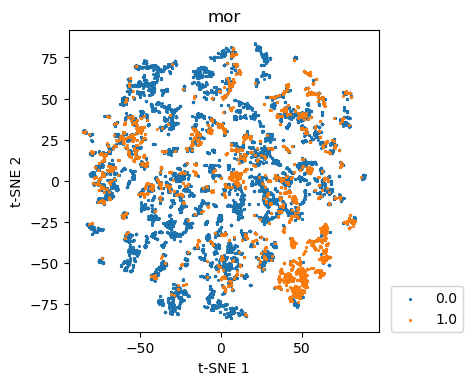

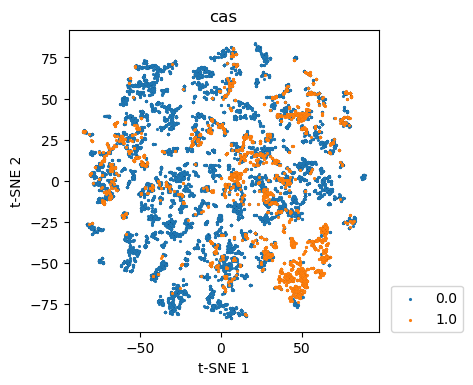

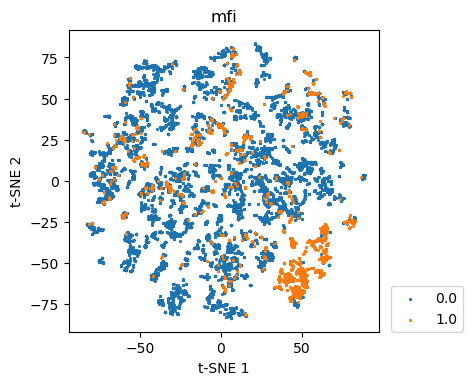

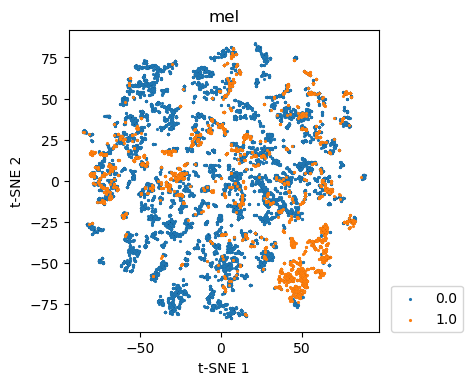

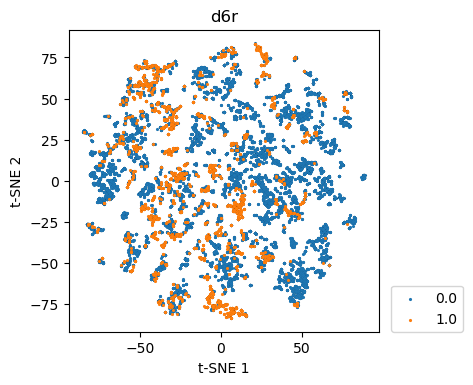

...

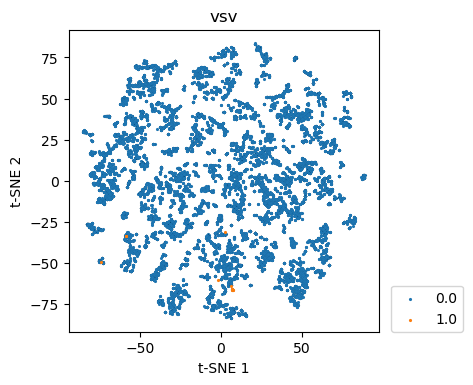

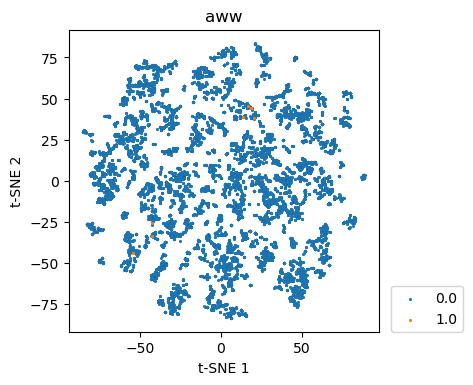

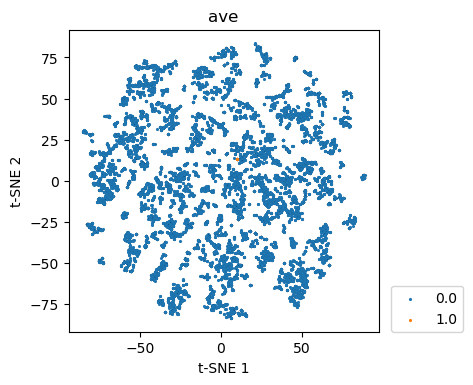

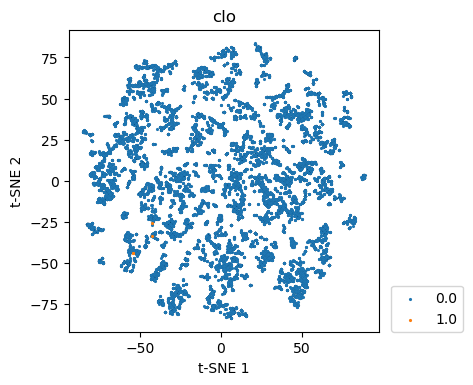

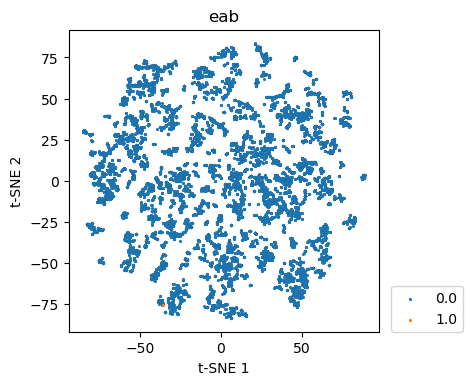

In [66]:
for cbu in cbus_unique:
    plt.figure(figsize = (4,4), dpi = 100)
    for label, data in df_without_na.groupby(cbu):
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 1, label = label,
                                edgecolor = 'black', linewidth = 0.01
                       )
    plt.title(cbu)
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.legend(loc=(1.04, 0))
    plt.show()

# OSDA hierarchical clustering 

In [67]:
def rmsd_matrix(A, B, squared=False, axis = 0):
    """
    Compute all pairwise distances between vectors in A and B.

    Parameters
    ----------
    A : np.array
        shape should be (M, K)
    B : np.array
        shape should be (N, K)

    Returns
    -------
    D : np.array
        A matrix D of shape (M, N).  Each entry in D i,j represnets the
        distance between row i in A and row j in B.

    See also
    --------
    A more generalized version of the distance matrix is available from
    scipy (https://www.scipy.org) using scipy.spatial.distance_matrix,
    which also gives a choice for p-norm.
    """
    M = A.shape[0]
    N = B.shape[0]

    assert A.shape[1] == B.shape[1], f"The number of components for vectors in A \
        {A.shape[1]} does not match that of B {B.shape[1]}!"

    A_dots = (A*A).sum(axis=1).reshape((M,1))*np.ones(shape=(1,N))
    B_dots = (B*B).sum(axis=1)*np.ones(shape=(M,1))
    if axis == 0:
        D_squared =  1/M*(A_dots + B_dots -2*A.dot(B.T))
    elif axis == 1:
        D_squared =  1/N*(A_dots + B_dots -2*A.dot(B.T))

    if squared == False:
        zero_mask = np.less(D_squared, 0.0)
        D_squared[zero_mask] = 0.0
        return np.sqrt(D_squared)

    return D_squared

In [68]:
n_osdas = 50
most_freq_osdas = list(df['osda1 smiles'].value_counts().iloc[:n_osdas].index)

In [69]:
# Select subset of OSDA features
df_osda = df_osda[[x for x in df_osda.columns if \
#                                                  | ('asphericity' in x) \
#                                                  | ('axes' in x) \
#                                                  | ('bertz_ct' in x) \
#                                                  | ('eccentricity' in x) \
#                                                  | ('formal_charge' in x) \
#                                                  | ('free_sasa' in x) \
#                                                  | ('gyration_radius' in x) \
#                                                  | ('inertial_shape_factor' in x) \
#                                                  | ('mol_weight' in x) \
#                                                  | ('npr1' in x) \
#                                                  | ('npr2' in x) \
#                                                  | ('num_bonds' in x) \
#                                                  | ('num_rot_bonds' in x) \
#                                                  | ('pmi1' in x) \
#                                                  | ('pmi2' in x) \
#                                                  | ('pmi3' in x) \
#                                                  | ('spherocity_index' in x) \
#                                                  | ('volume' in x) \
#                                                   ('whim' in x) \
                                                   ('morgan' in x) \
                                                 | ('osda smiles' in x) \
                                        ]]

# Keep only 100 most frequent OSDAs
df_osda = df_osda[df_osda['osda smiles'].isin(most_freq_osdas)]

df_osda_T = df_osda.T
df_osda_T = df_osda_T.drop(index = 'osda smiles')
df_osda_T.columns = df_osda['osda smiles']
df_osda_T

osda smiles,C1CCC2(C1)CCC[NH2+]2,C1CCCNCC1,C1CCNC1,C1CCNCC1,C1CN2CCC1CC2,C1COCCN1,C1COCCOCCOCCOCCOCCO1,CC(C)N,CC(C)NC(C)C,CC1CC(C)C[N+](C)(C)C1,...,C[N+]1(CCCCC[N+]2(C)CCCC2)CCCC1,C[N+]1(CCCC[N+]2(C)CCCC2)CCCC1,C[N+]1(Cc2ccccc2)CCC(CCCC2CC[N+](C)(Cc3ccccc3)CC2)CC1,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCCN2C1,Cc1n(C)cc[n+]1C,NC12CC3CC(CC(C3)C1)C2,NCCCCCCN,NCCN,c1ccc2c(c1)CC[N+]1(C2)Cc2ccccc2C1,c1ccc2c(c1)C[N+]1(CCCCC1)C2
osda_morgan0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
osda_morgan6870,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan6871,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan6872,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
osda_morgan6873,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [70]:
df_osda_T_scaled = (df_osda_T-df_osda_T.min())/(df_osda_T.max()-df_osda_T.min()).astype(float)
df_osda_T_scaled = df_osda_T_scaled.astype(float)

In [71]:
osda_rmsd = pd.DataFrame(rmsd_matrix(df_osda_T_scaled.T.to_numpy(), df_osda_T_scaled.T.to_numpy()),
                        index = df_osda_T_scaled.columns, columns = df_osda_T_scaled.columns)
osda_rmsd

osda smiles,C1CCC2(C1)CCC[NH2+]2,C1CCCNCC1,C1CCNC1,C1CCNCC1,C1CN2CCC1CC2,C1COCCN1,C1COCCOCCOCCOCCOCCO1,CC(C)N,CC(C)NC(C)C,CC1CC(C)C[N+](C)(C)C1,...,C[N+]1(CCCCC[N+]2(C)CCCC2)CCCC1,C[N+]1(CCCC[N+]2(C)CCCC2)CCCC1,C[N+]1(Cc2ccccc2)CCC(CCCC2CC[N+](C)(Cc3ccccc3)CC2)CC1,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCCN2C1,Cc1n(C)cc[n+]1C,NC12CC3CC(CC(C3)C1)C2,NCCCCCCN,NCCN,c1ccc2c(c1)CC[N+]1(C2)Cc2ccccc2C1,c1ccc2c(c1)C[N+]1(CCCCC1)C2
osda smiles,,,,,,,,,,,,,,,,,,,,,
C1CCC2(C1)CCC[NH2+]2,3.141441e-09,0.194825,0.196627,0.179139,0.216683,0.228807,0.406020,0.330601,0.328494,0.313346,...,0.267023,0.255051,0.343135,0.177943,0.341620,0.270284,0.308382,0.370236,0.329549,0.237141
C1CCCNCC1,1.948247e-01,0.000000,0.124226,0.086210,0.238307,0.221875,0.417961,0.345161,0.343143,0.328671,...,0.275407,0.263816,0.357184,0.194047,0.355729,0.289742,0.323942,0.383293,0.344153,0.243768
C1CCNC1,1.966269e-01,0.124226,0.000000,0.064979,0.233069,0.200693,0.414997,0.341565,0.339526,0.324893,...,0.277639,0.266145,0.353710,0.194625,0.352241,0.285450,0.320108,0.380058,0.340547,0.249489
C1CCNCC1,1.791388e-01,0.086210,0.064979,0.000000,0.222832,0.198746,0.409336,0.334664,0.332582,0.317630,...,0.264942,0.252872,0.347051,0.177753,0.345554,0.277155,0.312734,0.373869,0.333625,0.233246
C1CN2CCC1CC2,2.166827e-01,0.238307,0.233069,0.222832,0.000000,0.241842,0.413507,0.339753,0.337703,0.317202,...,0.294890,0.284095,0.336907,0.187876,0.346944,0.269888,0.318174,0.378431,0.338729,0.265583
C1COCCN1,2.288069e-01,0.221875,0.200693,0.198746,0.241842,0.000000,0.370810,0.347611,0.345607,0.331243,...,0.303910,0.293447,0.359552,0.223889,0.358107,0.292657,0.326551,0.385501,0.346611,0.275564
C1COCCOCCOCCOCCOCCO1,4.060205e-01,0.417961,0.414997,0.409336,0.413507,0.370810,0.000000,0.483046,0.481606,0.471405,...,0.452616,0.445658,0.491709,0.403269,0.490653,0.445138,0.468119,0.510990,0.482327,0.434091
CC(C)N,3.306010e-01,0.345161,0.341565,0.334664,0.339753,0.347611,0.483046,0.000000,0.178730,0.333333,...,0.371745,0.363242,0.410420,0.320983,0.310316,0.372678,0.334258,0.372678,0.400520,0.364527
CC(C)NC(C)C,3.284938e-01,0.343143,0.339526,0.332582,0.337703,0.345607,0.481606,0.178730,0.000000,0.331243,...,0.369872,0.361325,0.408724,0.318813,0.308070,0.375771,0.343143,0.399653,0.398783,0.362617


/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/seaborn/matrix.py:625: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  metric=self.metric)


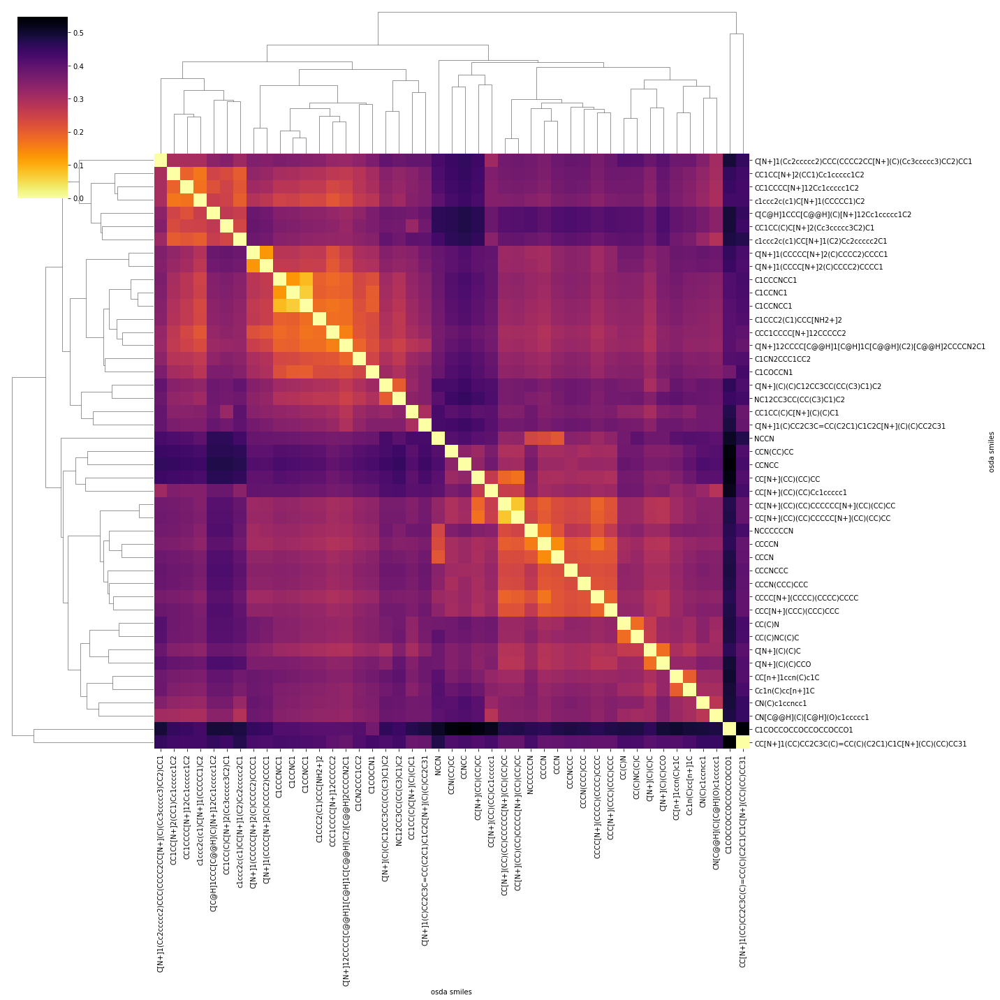

In [72]:
sns.clustermap(osda_rmsd, cmap = "inferno_r", figsize=(20, 20))

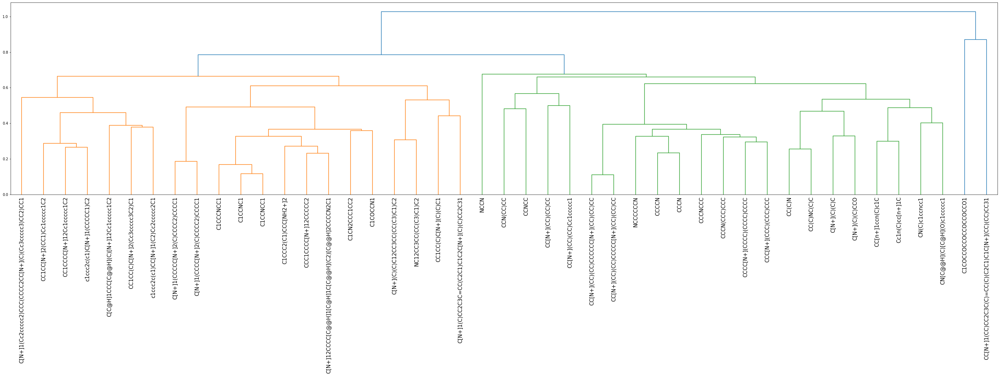

In [73]:
row_linkage = hierarchy.linkage(
    distance.pdist(osda_rmsd.to_numpy()), method='average')

fig = plt.figure(figsize=(50, 10))
ax = fig.add_subplot(1, 1, 1)

dendro = hierarchy.dendrogram(row_linkage, labels = osda_rmsd.columns.tolist(), ax = ax)
ax.tick_params(axis='x', which='major', labelsize=15)

plt.show()

In [74]:
df_zeos

,Code,crystal,num_atoms,a,b,c,alpha,beta,gamma,volume,...,deriv_dist_290,deriv_dist_291,deriv_dist_292,deriv_dist_293,deriv_dist_294,deriv_dist_295,deriv_dist_296,deriv_dist_297,deriv_dist_298,deriv_dist_299
0,-CLO,59490821,588,25.840000,25.840000,25.840000,90.000000,90.000000,90.000000,17253.512704,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,CHI,59490820,88,5.010000,31.234000,9.012000,90.000000,90.000000,90.000000,1410.218848,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-IFU,59490859,388,26.035780,25.589510,15.824810,90.000000,90.000000,90.000000,10543.166557,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,*-ITN,59490871,163,24.200500,12.539900,14.250200,72.599000,123.128000,90.000000,3382.798050,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,IWV-supercell,59490878,456,27.826000,26.081000,13.944000,90.000000,90.000000,90.000000,10119.577809,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257,AFO,254821062,120,9.591386,25.456866,8.278569,90.000020,90.000000,89.999847,2021.350279,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
258,YFI,254821724,360,18.047851,31.592710,12.416768,90.000010,90.000020,89.999926,7079.799269,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259,PSI,254979219,432,8.303366,22.235896,37.911229,89.952443,90.000006,90.000003,6999.653322,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
260,DON,254994677,192,18.915800,22.991712,8.468475,89.999998,90.000000,89.999361,3682.995888,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


[450.4628000000001, 211.82400000000007, 211.49066666666675, 194.90400000000005, 228.16000000000005, 228.39733333333345, 233.16400000000004, 273.9995294117648, 257.32266666666663, 113.1416, 80.50000000000001, 96.64600000000004, 139.30933333333334, 206.2040000000001, 263.22800000000007, 119.62800000000004, 89.72600000000001, 211.98800000000008, 158.10400000000004, 167.33600000000004, 287.79733333333337, 69.72857142857144, 124.74628571428572, 91.21800000000002, 161.28400000000005, 216.74971428571436, 345.5373333333334, 328.625142857143, 136.82960000000003, 90.95600000000005, 74.16500000000002, 124.6574285714286, 175.00720000000004, 295.6556000000001, 228.5840000000001, 74.09800000000003, 124.58133333333336, 94.55200000000002, 120.31200000000004, 134.29600000000002, 117.62133333333335, 124.70800000000004, 171.82800000000006, 256.64060000000006, 363.4906666666668]
[108.506536890725, 124.09432161338681, 124.09432161338681, 124.09432161338681, 245.27248289523604, 245.27248289523604, 132.86148

/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:167: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:182: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:182: MatplotlibDeprecationWarning: Passing 

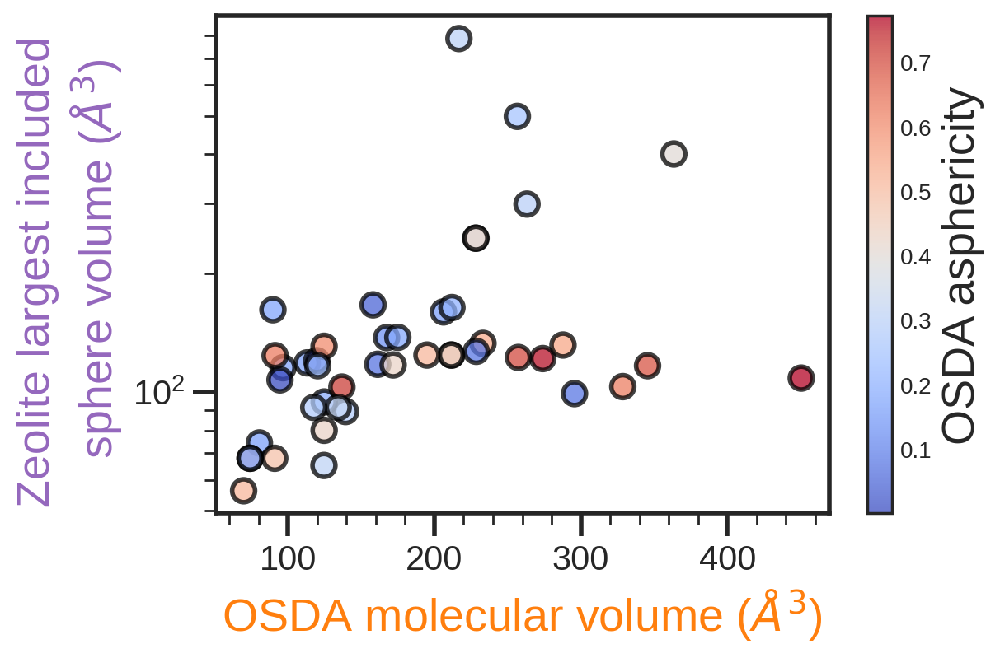

In [75]:
def smoothsegment(seg, Nsmooth=100):
    return np.concatenate([[seg[0]], np.linspace(seg[1], seg[2], Nsmooth), [seg[3]]])

def plot_dendrogram(icoord,dcoord,figsize, osda_labels = [], polar=False):
    if polar:
        radius = 20 # radius of circle
        dcoord = -dcoord*radius
#         dcoord = -np.log(dcoord+1)*radius
        gap = 0.1
        imax = icoord.max()
        imin = icoord.min()
        icoord = ((icoord - imin)/(imax - imin)*(1-gap) + gap/2)*2*np.pi
        
    with plt.style.context("seaborn-white"):
        fig = plt.figure(figsize=figsize, dpi =300)
        ax = fig.add_subplot(111, polar=polar)
        
        for xs, ys in zip(icoord, dcoord):
            start, end = xs[0], xs[2]
            
            # Default colors
            color = 'black'
            linewidth = 3
            
#             # Grp A
#             if (start > 0) and (end < 1.2) and (ys[1] > -12):
#                 color     = 'tab:red'
#                 linewidth = 7
                
#             # Grp B
#             if (start > 1.2) and (end < 2.4) and (ys[1] > -12):
#                 color     = 'tab:green'
#                 linewidth = 7
                
#             # Grp C
#             if (start > 2.4) and (end < 3.0) and (ys[1] > -12):
#                 color     = 'tab:blue'
#                 linewidth = 7
            
#             # Grp D
#             if (start > 3.0) and (end < 4.8) and (ys[1] > -12):
#                 color     = 'tab:purple'
#                 linewidth = 7
            
#             # Grp E
#             if (start > 4.8) and (end < 6.0) and (ys[1] > -12):
#                 color     = 'tab:orange'
#                 linewidth = 7
            
            if polar:
                xs = smoothsegment(xs)
                ys = smoothsegment(ys)
                
            
            ax.plot(xs,ys, color=color, 
                        linewidth=linewidth
                       )
        if polar:
            ax.spines['polar'].set_visible(False)
            ax.set_xticks([])
            ax.set_yticks([])
#             ax.set_rlabel_position(0)
            Nxticks = len(osda_labels)
            xticks = np.linspace(gap/2, 1-gap/2, Nxticks)
            ax.set_xticks(xticks*np.pi*2)

            ax.set_xticklabels(osda_labels)
            ax.xaxis.grid(False)
            
            
            labels = []
            mol_vols = [] # molecule vol
            mol_asphs = [] # molecule asphericity
            num_zeos = [] # OSDA specificity
            pore_sizes = []
            ring_sizes = []
            angles = []
            for label, angle in zip(ax.get_xticklabels(), xticks*np.pi*2):
                
#                 x,y = angle, 0
#                 lab = ax.text(x,y, label.get_text(), 
#                               transform=label.get_transform(),
#                               ha=label.get_ha(), va=label.get_va(),
#                              fontsize = 20,
#                              )
#                 degrees = np.degrees(angle)
#                 if degrees > 90 and degrees < 270:
#                     degrees = degrees + 180
#                 lab.set_rotation(degrees)
#                 labels.append(lab)
                
                
#                 Draw molecule
                smiles = label.get_text()
                mol = Chem.MolFromSmiles(smiles)
                o = Draw.DrawingOptions()
                o.bgColor = None # make background transparent - but doesn't seem to work?
                mol_img = Draw.MolToImage(mol, options=o, size=(150, 150))
#                 mol_img.rotate(90)
                r = 0.41 # radius of molecule images in fractional
                x_cor, y_cor = -0.01, -0.02 # correction in x y fractions
                img_ax = fig.add_axes([0.5+r*np.cos(angle)+x_cor,0.5+r*np.sin(angle)+y_cor,0.045,0.045], anchor='C', zorder=1)
                img_ax.imshow(mol_img)
#                 img_ax.imshow(mol_img.rotate(np.degrees(angle)))
                img_ax.axis('off')
    
                # Get properties
                mol_vol = df_osda_all_feats[df_osda_all_feats['osda smiles'] == smiles]['osda_volume_mean_0'].item()
                mol_asph = df_osda_all_feats[df_osda_all_feats['osda smiles'] == smiles]['osda_asphericity_mean_0'].item()
            
                num_zeo = 1/len(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts())
                
                ring_size = df_zeos[df_zeos['Code'].isin(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts().index)]['ring_size_0'].mean()
                
                pore_rads = df_zeos[df_zeos['Code'].isin(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts().index)]['largest_included_sphere']/2. # pore radiuses of all zeolites formed by this OSDA
                pore_size = (4/3*np.pi*(pore_rads**3)).median() # mean of pore volume of all zeolites formed by this OSDA
                
                
                
#                 # annotate with property - OSDA asphericity
#                 x,y = angle, -0.20
#                 lab = ax.text(x,y, round(mol_asph, 3), 
#                               transform=label.get_transform(),
#                               ha=label.get_ha(), va=label.get_va(),
#                              fontsize = 30,
#                              )
#                 degrees = np.degrees(angle)
#                 if degrees > 90 and degrees < 270:
#                     degrees = degrees + 180
#                 lab.set_rotation(degrees)
#                 labels.append(lab)
                
               
                angles.append(angle)
                mol_vols.append(mol_vol)
                mol_asphs.append(mol_asph)
                num_zeos.append(num_zeo)
                pore_sizes.append(pore_size)
                ring_sizes.append(ring_size)
            
            print(mol_vols)
            
            print(pore_sizes)
            
            ax.set_xticklabels([])
            ax.set_ylim(top = 2)
            
            
            # Define angles
            n = len(mol_vols)
            step_size = (angles[-1] - angles[0])/(n-1) # step size in radians
            start = angles[0] - step_size/2 # start angle in radians
            end   = angles[-1] + step_size/2# end angle in radians
            a = np.linspace(start, end, n+1) # angles
            
            # Plot property colors - OSDA mol vol
            rad = np.linspace(0, 0.8, n) # radius of coloring, 1st and 2nd correspond to start and end of radius. 0 correspond to outmost radius
            r, th = np.meshgrid(rad, a)
            z = np.array(mol_vols)
            z = np.vstack(n*[z]).T
            mesh = ax.pcolormesh(th, r, z, cmap ='Oranges')
            ax.plot(a, r, ls='none') 
            cbar_pos = fig.add_axes([0.8,0.43,0.01,0.15])
            cbar = fig.colorbar(mappable = mesh, cax=cbar_pos, ticks=np.arange(0, 500, 100))
            cbar.ax.set_yticklabels(np.arange(0, 500, 100))
            cbar.set_label(label = 'OSDA molecular volume ($\AA^3$)', size=30, rotation=270, labelpad=40)
            cbar.ax.tick_params(labelsize=20) 
            
            # Plot property colors - zeolite pore volume
            rad = np.linspace(1.0, 1.8, n) # radius of coloring, 1st and 2nd correspond to start and end of radius. 0 correspond to outmost radius
            r, th = np.meshgrid(rad, a)
            z = np.array(pore_sizes)
            z = np.vstack(n*[z]).T
            mesh = ax.pcolormesh(th, r, z, cmap ='Purples', 
                                 vmin=100, vmax= 200,
                                 norm = LogNorm()
                                )
            ax.plot(a, r, ls='none')
            cbar_pos = fig.add_axes([0.87,0.43,0.01,0.15])
            cbar = fig.colorbar(mappable = mesh, cax=cbar_pos
                                , ticks=[100, 200],
                               )
            cbar.ax.set_yticklabels(['100', '$\geq$200'])
            cbar.ax.minorticks_off()
            cbar.set_label(label = 'Zeolite largest included \n sphere volume ($\AA^3$)', size=30, rotation=270, labelpad=40)
            cbar.ax.tick_params(labelsize=20) 
        
        
        print(scipy.stats.pearsonr(mol_vols, pore_sizes))
        print(scipy.stats.spearmanr(mol_vols, pore_sizes))
        
        
        fig, ax = plt.subplots(dpi=200)
        plt.scatter(mol_vols, pore_sizes, c = mol_asphs, cmap = 'coolwarm', s = 100, alpha = 0.75, edgecolor = 'black', linewidth = 2)
#         plt.plot([0,1000], [0,1000], linestyle = '--')
        plt.xlabel('OSDA molecular volume ($\AA^3$)', fontsize = 20, color = 'tab:orange')
        plt.ylabel('Zeolite largest included \n sphere volume ($\AA^3$)', fontsize = 20, color = 'tab:purple')
        plt.yscale('log')
        cbar = plt.colorbar()
        cbar.set_label(label = 'OSDA asphericity', fontsize = 20)
        
        
        # Set the line thickness of the axes
        ax.spines['top'].set_linewidth(2)    # Top axis line
        ax.spines['right'].set_linewidth(2)  # Right axis line
        ax.spines['bottom'].set_linewidth(2) # Bottom axis line
        ax.spines['left'].set_linewidth(2)   # Left axis line
        
        plt.minorticks_on()
        plt.tick_params(axis='y', which='major', length=10, width=2)
        plt.tick_params(axis='y', which='minor', length=5, width=1)
        plt.tick_params(axis='x', which='major', length=10, width=2)
        plt.tick_params(axis='x', which='minor', length=5, width=1)
        
        plt.xticks(fontsize=15)
        plt.yticks(fontsize=15)
#         plt.xlim(min(mol_vols),500)
#         plt.ylim(min(pore_sizes),400)
        plt.show()
                
    return fig, ax

labels = df_osda_T_scaled.columns.tolist()
cols = [labels[i] for i in dendro['leaves']]

fig, ax = plot_dendrogram(np.array(dendro['icoord']), np.array(dendro['dcoord']), (30,30), 
                osda_labels = cols, polar = True)
# fig.savefig('figs/polar_dendrogram.pdf', bbox_inches='tight', transparent=True)
fig.show()

# Correlation plot

In [76]:
# corr = df_tsne[[x for x in tsne_cols if 'osda' not in x]].corr().round(decimals=1)

# mask = np.triu(np.ones_like(corr, dtype=bool))

# fig, ax = plt.subplots(figsize=(25,25))

# sns.set_style("whitegrid")
# ax = sns.heatmap(
#     corr, 
#     mask = mask,
#     vmin=-1, vmax=1, center=0,
#     square=True,
#     annot = True,
#     annot_kws={"fontsize":17},
#     cmap = 'RdBu',
#     cbar_kws={"shrink": 0.75}
# )
# ax.set_xticklabels(
#     ax.get_xticklabels(),
#     rotation=90,
# #     horizontalalignment='right',
#     size = 30
# );
# ax.set_yticklabels(
#     ax.get_yticklabels(),
#     rotation=360,
# #     horizontalalignment='right',
#     size = 30
# );
# cbar = ax.collections[0].colorbar
# cbar.ax.tick_params(labelsize=25)
# cbar.set_label('Pearson correlation coefficient', fontsize = 30)

# Explain OSDA/T ranging from 0-1 instead of 0.05

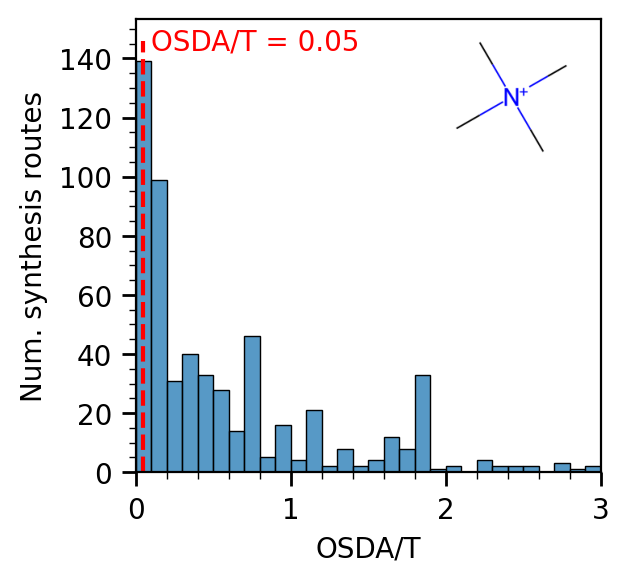

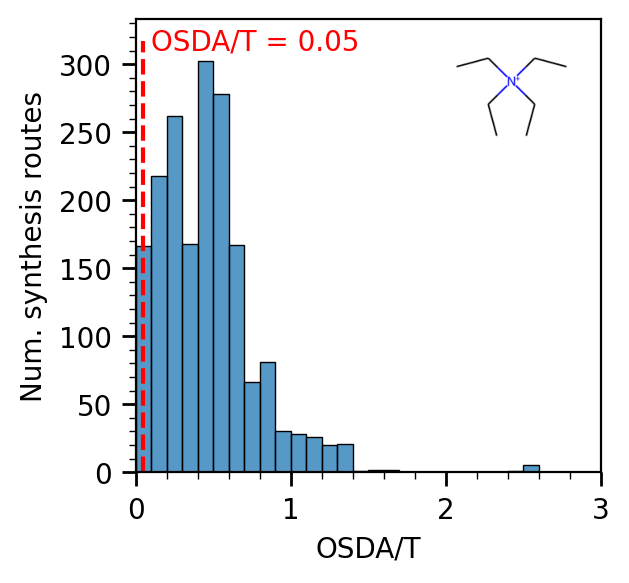

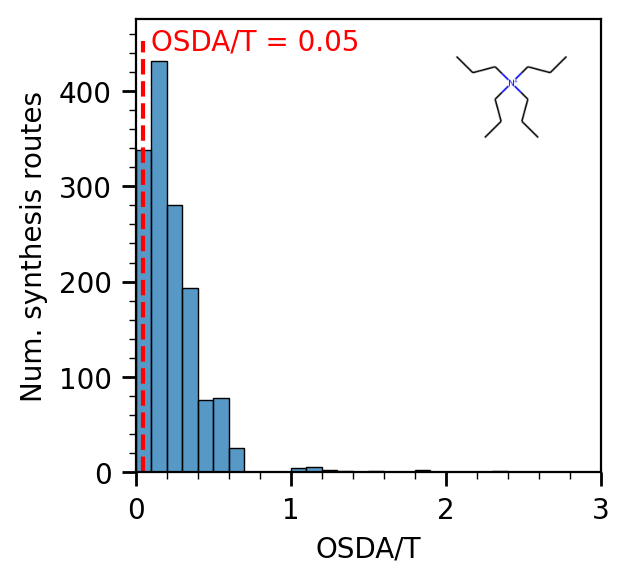

In [77]:
sda = ['C[N+](C)(C)C', 'CC[N+](CC)(CC)CC', 'CCC[N+](CCC)(CCC)CCC']
xlim = (0.,3.)

for s in sda:
    sda_df = df[df['osda1 smiles'] == s]

    sda_T = sda_df['sda1']/sda_df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)

    fig = plt.figure(figsize = (3,3),dpi = 200)
    sns.histplot(sda_T, binrange = xlim, bins = 30)
    xmin, xmax, ymin, ymax = plt.axis()
    plt.plot([0.05, 0.05], [0, ymax], linestyle = '--', c = 'red')
    plt.text(0.05*2, ymax*0.98, s = 'OSDA/T = 0.05', c = 'red')
    plt.xlim(*xlim)
    plt.xlabel('OSDA/T')
    plt.ylabel('Num. synthesis routes')
    
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=5, width=1)
    plt.tick_params(axis='y', which='minor', length=2.5, width=0.5)
    plt.tick_params(axis='x', which='major', length=5, width=1)
    plt.tick_params(axis='x', which='minor', length=2.5, width=0.5)
    
    
    mol = Chem.MolFromSmiles(s)
    o = Draw.DrawingOptions()
    o.bgColor = None
    mol_img = Draw.MolToImage(mol, options=o, size=(150, 150))
    inset = fig.add_axes([0.65, 0.65, .2, .2])
    inset.imshow(mol_img)
    inset.axis('off')
    plt.setp(inset, xticks=[], yticks=[])
    
    plt.show()


# Looking at Na/T ratios

(0.0, 2.5)

<Figure size 432x288 with 0 Axes>

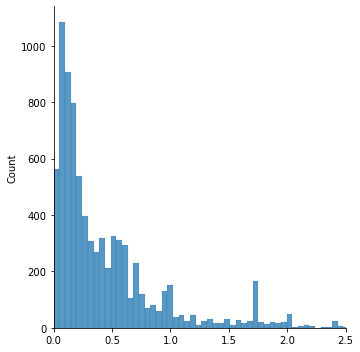

In [78]:
plt.figure()
sns.displot(NaT_ratio)
plt.xlim(0,2.5)

In [79]:
scipy.stats.percentileofscore(NaT_ratio, 0.46)

63.721940622737144